# main

In [1]:
! pip install wget

In [2]:
# ! pip install -q git+https://github.com/pycroscopy/atomai

In [3]:
# ! pip install -q kornia atomai git+https://github.com/ziatdinovmax/pyroVED@main

Import libraries

In [4]:
#from atomai import utils
from atomai import stat as atomstat
import atomai as aoi

In [5]:
#from atomai import utils
# from atomai import stat as atomstat
# import atomai as aoi
import numpy as np
import pyroved as pv

import torch
import random
tt = torch.tensor
# Setting seeds to reproduce the results
torch.manual_seed(0)
torch.cuda.manual_seed_all(0)
torch.backends.cudnn.deterministic=True
np.random.seed(0)
random.seed(0)

In [106]:
import os
import wget
from sklearn.preprocessing import StandardScaler
import h5py
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from skimage import feature
import skimage
from scipy.ndimage import zoom
from matplotlib.patches import Rectangle
# import seaborn as sns
import ipywidgets as widgets
from ipywidgets import interact
import ipywidgets

Upload Dataset

The dataset we have plan to work on represents unit cell (UC) information, and crystallographic properties of Sm-doped BiFeO₃ . Here’s an explanation of each parameter in this context:

**I1, I2, I3, I4, I5**: These correspond to intensity measurements at specific points or regions in the unit cell.

**NCOM (Number of Centers of Mass)**: Indicates the number of calculated or observed centers of mass within the unit cell. This parameter could be used to understand atomic or molecular arrangement in the unit cell.

**PCOM (Primary Center of Mass)**: Refers to the primary center of mass for the unit cell, potentially indicating the most significant mass concentration point. This can help in analyzing symmetry or balancing structural information.

**Pxy**: Pxy would specifically quantify the in-plane polarization vector within the x and y dimensions. The values in Pxy are essential for understanding how the electric dipole moments are distributed within the unit cell and whether there are tendencies for domains to form or align under external fields.

**Vol (Volume)**: Refers to the volume of the unit cell, which is essential for calculations related to density and lattice spacing. Changes in volume can signal phase transitions or structural changes under different conditions.

**a, b**: These are lattice parameters along two main crystallographic axes. In crystallography, the lattice constants define the periodicity and distances between atoms in each direction.

**ab, adelta, bdelta**:

ab: Likely the in-plane lattice parameter, which might be averaged or specific to the 'a' and 'b' directions combined.
adelta and bdelta: Represent the deviations or variations in the lattice parameters a and b, which can indicate strain or defects within the crystal structure.
alpha: Typically represents an angle in crystallography (e.g., between lattice vectors), providing information about the unit cell’s geometry (e.g., whether it’s orthorhombic, monoclinic, etc.).

**atmindex (Atom Index)**: An identifier for different atoms within the unit cell, essential for linking positional data with specific atoms.

**index**: Possibly a general identifier or label for the unit cell instance within the dataset, useful for tracking or referencing each cell.

**meanuca and meanucb**: Likely represent the mean values of the lattice parameters 'a' and 'b' across the dataset or a subset of unit cells, providing an average view of these dimensions.

**nbrUC (Number of Unit Cells)**: Indicates the number of unit cells considered in this particular dataset or measurement set. This provides context for scale and sample size.

**xy_COM (xy Center of Mass)**: X and Y coordinates of the center of mass for the unit cell, helpful for assessing symmetry and spatial positioning within the plane.

**xy_atms (xy Atom Positions)**: The X and Y coordinates of atoms within the unit cell, specifying their positions relative to the cell origin, which is essential for visualizing and analyzing the atomic arrangement.

Each **Sm_0_0_HAADF.h5** contains the Scanning Transmission Electron Microscopy (STEM) image for Sm-substituted BiFeO₃ (SmBFO) for different compositions.

In [7]:
# model_files = ['Sm_0_0_HAADF.h5','Sm_0_1_HAADF.h5','Sm_0_2_HAADF.h5',
#                'Sm_0_0_UCParameterization.h5','Sm_0_1_UCParameterization.h5','Sm_0_2_UCParameterization.h5',
#                'Sm_7_0_HAADF.h5','Sm_7_1_HAADF.h5', 'Sm_7_2_HAADF.h5', 'Sm_7_3_HAADF.h5', 'Sm_7_4_HAADF.h5',
#                'Sm_7_0_UCParameterization.h5','Sm_7_1_UCParameterization.h5','Sm_7_2_UCParameterization.h5','Sm_7_3_UCParameterization.h5','Sm_7_4_UCParameterization.h5',
#                'SM_10_0_HAADF.h5','Sm_10_1_HAADF.h5',
#                'Sm_10_0_UCParameterization.h5','Sm_10_1_UCParameterization.h5',
#                'Sm_13_0_HAADF.h5','Sm_13_1_HAADF.h5',
#                'Sm_13_0_UCParameterization.h5','Sm_13_1_UCParameterization.h5',
#                'Sm_20_0_HAADF.h5','Sm_20_1_HAADF.h5',
#                'Sm_20_0_UCParameterization.h5','Sm_20_1_UCParameterization.h5']

# for model_file in model_files:
#   print(model_file)
#   wget.download("https://zenodo.org/record/4555979/files/"+model_file+"?download=1", out=model_file)

In [8]:
#list files
filedir = '/Users/kbarakat/Library/CloudStorage/OneDrive-UniversityofTennessee/Documents/ferro_VAE/notebooks/data'
[f for f in os.listdir(filedir)]

['Sm_0_1_UCParameterization.h5',
 'Sm_13_0_HAADF.h5',
 'Sm_7_0_UCParameterization.h5',
 'Sm_7_0_HAADF.h5',
 'SM_10_0_HAADF.h5',
 'Sm_13_0_UCParameterization.h5',
 'Sm_10_0_UCParameterization.h5',
 'Sm_20_1_HAADF.h5',
 'Sm_20_1_UCParameterization.h5',
 'Sm_0_1_HAADF.h5']

In [14]:

filedir = '/Users/kbarakat/Library/CloudStorage/OneDrive-UniversityofTennessee/Documents/ferro_VAE/notebooks/data'
#image files
composition_tags = [0,7,10,13,20]    #Sm composition %


img_filename = ['Sm_0_1_HAADF.h5',
                'Sm_7_0_HAADF.h5',
                'SM_10_0_HAADF.h5',
                'Sm_13_0_HAADF.h5',
                'Sm_20_1_HAADF.h5']

imnum = len(img_filename)

#paramterization files

UCparam_filename = ['Sm_0_1_UCParameterization.h5',
                    'Sm_7_0_UCParameterization.h5',
                    'Sm_10_0_UCParameterization.h5',
                    'Sm_13_0_UCParameterization.h5',
                    'Sm_20_1_UCParameterization.h5']

#load parameter files
UCparam = []
for x in UCparam_filename:
  print('loading parameterization file: ', os.path.join(filedir, x))
  temp = h5py.File(os.path.join(filedir, x), 'r')
  UCparam.append(temp)

#load images
imgdata = []
for x in img_filename:
  print('loading image file: ', os.path.join(filedir, x))
  temp = h5py.File(os.path.join(filedir, x), 'r')['MainImage']
  imgdata.append(temp)

print('UC parameterization:', [k for k in UCparam[0].keys()])

loading parameterization file:  /Users/kbarakat/Library/CloudStorage/OneDrive-UniversityofTennessee/Documents/ferro_VAE/notebooks/data/Sm_0_1_UCParameterization.h5
loading parameterization file:  /Users/kbarakat/Library/CloudStorage/OneDrive-UniversityofTennessee/Documents/ferro_VAE/notebooks/data/Sm_7_0_UCParameterization.h5
loading parameterization file:  /Users/kbarakat/Library/CloudStorage/OneDrive-UniversityofTennessee/Documents/ferro_VAE/notebooks/data/Sm_10_0_UCParameterization.h5
loading parameterization file:  /Users/kbarakat/Library/CloudStorage/OneDrive-UniversityofTennessee/Documents/ferro_VAE/notebooks/data/Sm_13_0_UCParameterization.h5
loading parameterization file:  /Users/kbarakat/Library/CloudStorage/OneDrive-UniversityofTennessee/Documents/ferro_VAE/notebooks/data/Sm_20_1_UCParameterization.h5
loading image file:  /Users/kbarakat/Library/CloudStorage/OneDrive-UniversityofTennessee/Documents/ferro_VAE/notebooks/data/Sm_0_1_HAADF.h5
loading image file:  /Users/kbarakat/

## Physical descriptors: polarization, strain, lattice parameters

In [15]:
#function maps x,y grid positions into a matrix data format
def map2grid(inab, inVal):

  default_val = np.nan
  abrng = [int(np.min(inab[:,0])), int(np.max(inab[:,0])), int(np.min(inab[:,1])), int(np.max(inab[:,1]))]
  abind = inab
  abind[:,0] -= abrng[0]
  abind[:,1] -= abrng[2]
  Valgrid = np.empty((abrng[1]-abrng[0]+1,abrng[3]-abrng[2]+1))
  Valgrid[:] = default_val
  Valgrid[abind[:,0].astype(int),abind[:,1].astype(int)]=inVal[:]
  return Valgrid, abrng

In [16]:
SBFOdata = []     #this will be the output list of dictionaries for each dataset

for i in np.arange(imnum):
  temp_dict = {'Index': i}
  temp_dict['Composition'] = composition_tags[i]
  temp_dict['Image'] = imgdata[i]
  temp_dict['Filename'] = img_filename[i]

  for k in UCparam[i].keys():       #add labels for UC parameterization
    temp_dict[k] = UCparam[i][k][()]

  #select values mapped to ab grid
  temp_dict['ab_a'] = map2grid(UCparam[i]['ab'][()].T, UCparam[i]['ab'][()].T[:,0])[0]       #a array
  temp_dict['ab_b'] = map2grid(UCparam[i]['ab'][()].T, UCparam[i]['ab'][()].T[:,1])[0]       #b array
  temp_dict['ab_x'] = map2grid(UCparam[i]['ab'][()].T, UCparam[i]['xy_COM'][()].T[:,0])[0]   #x array
  temp_dict['ab_y'] = map2grid(UCparam[i]['ab'][()].T, UCparam[i]['xy_COM'][()].T[:,1])[0]   #y array
  temp_dict['ab_Px'] = map2grid(UCparam[i]['ab'][()].T, UCparam[i]['Pxy'][0])[0]             #Px array
  temp_dict['ab_Py'] = map2grid(UCparam[i]['ab'][()].T, UCparam[i]['Pxy'][1])[0]        #Py array
  temp_dict['Vol'] = map2grid(UCparam[i]['ab'][()].T, UCparam[i]['Vol'])[0]     #Vol array

  SBFOdata.append(temp_dict)

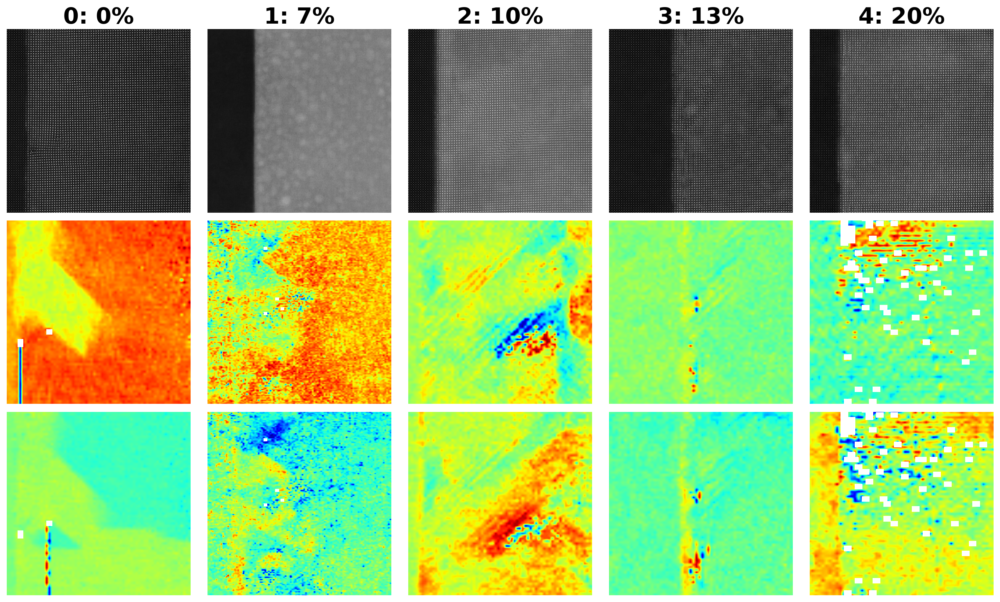

In [17]:
# Define the main area to be highlighted with a red square
main = [1000, 3000, 400, 2400]  # [y_start, y_end, x_start, x_end]

# Example: Resizing ab_Px and ab_Py, and plotting the selected region
for i in np.arange(imnum):
    img_shape = SBFOdata[i]["Image"].shape  # Target shape
    px_shape = SBFOdata[i]["ab_Px"].shape  # Current shape of ab_Px
    py_shape = SBFOdata[i]["ab_Py"].shape  # Current shape of ab_Py

    # Calculate the zoom factor for resizing ab_Px and ab_Py
    zoom_factors_px = [img_shape[0] / px_shape[0], img_shape[1] / px_shape[1]]
    zoom_factors_py = [img_shape[0] / py_shape[0], img_shape[1] / py_shape[1]]

    # Resize ab_Px and ab_Py to match the Image shape and ensure they are exactly the same size
    SBFOdata[i]["ab_Px_resized"] = zoom(SBFOdata[i]["ab_Px"], zoom_factors_px, order=1)
    SBFOdata[i]["ab_Py_resized"] = zoom(SBFOdata[i]["ab_Py"], zoom_factors_py, order=1)

    # Ensure the resized arrays match the image shape exactly (if rounding issues occur)
    SBFOdata[i]["ab_Px_resized"] = SBFOdata[i]["ab_Px_resized"][:img_shape[0], :img_shape[1]]
    SBFOdata[i]["ab_Py_resized"] = SBFOdata[i]["ab_Py_resized"][:img_shape[0], :img_shape[1]]

# Create figure with subplots for the selected data points
fig, ax = plt.subplots(nrows=3, ncols=5, figsize=(3*5, 3*3), dpi=200)

for j, idx in enumerate(np.arange(imnum)):
    k = SBFOdata[idx]

    # Image - select the region
    selected_image = k['Image'][main[0]:main[1], main[2]:main[3]]
    ax[0, j].imshow(selected_image, origin='upper', cmap='gray')
    ax[0, j].set_title(f"{k['Index']}: {k['Composition']}%", fontsize=24, fontweight="bold")
    ax[0, j].set_axis_off()
    ax[0, j].invert_yaxis()

    # Px - select the region
    selected_px = k['ab_Px_resized'][main[0]:main[1], main[2]:main[3]]
    ax[1, j].imshow(selected_px, origin='upper', cmap='jet')
    ax[1, j].set_axis_off()
    ax[1, j].invert_yaxis()

    # Py - select the region
    selected_py = k['ab_Py_resized'][main[0]:main[1], main[2]:main[3]]
    ax[2, j].imshow(selected_py, origin='upper', cmap='jet')
    ax[2, j].set_axis_off()
    ax[2, j].invert_yaxis()

plt.tight_layout()
plt.show()

As you can see, this carefully curated dataset provides access to the raw imaging data and to the order parameter fields including poalrization components, strains, unit cell parameters, column intensities, and so on. The data set was curated to explude regions around defects.

Select a part of the image to save time in analysis

In [18]:
# Let's create new lists to store the selected images, Px, and Py data
selected_images = []
ground_truth_px = []
ground_truth_py = []

# Define the main area to be highlighted
main = [1000, 3000, 400, 2400]  # [y_start, y_end, x_start, x_end]

# Loop over the selected indices, extract the region, and store it
for i in np.arange(imnum):
    k = SBFOdata[i]

    # Select the region from the image, Px, and Py
    selected_image = k['Image'][main[0]:main[1], main[2]:main[3]]
    selected_px = k['ab_Px_resized'][main[0]:main[1], main[2]:main[3]]
    selected_py = k['ab_Py_resized'][main[0]:main[1], main[2]:main[3]]

    # Append the selected regions to the corresponding lists
    selected_images.append(selected_image)
    ground_truth_px.append(selected_px)
    ground_truth_py.append(selected_py)

# The selected images, ground truth Px, and ground truth Py have been stored in the lists:
# selected_images, ground_truth_px, and ground_truth_py
# I will now display a confirmation of the stored data.
len(selected_images), len(ground_truth_px), len(ground_truth_py)


(5, 5, 5)

Define function for analysis

In [19]:
# min-max normalization:
def norm2d(img: np.ndarray) -> np.ndarray:
    return (img - np.min(img)) / (np.max(img) - np.min(img))

In [20]:
def custom_extract_subimages(imgdata, coordinates, w_prime):
    # Stage 1: Extract subimages with a fixed size (64x64)
    large_window_size = (64, 64)
    half_height_large = large_window_size[0] // 2
    half_width_large = large_window_size[1] // 2
    subimages_largest = []
    coms_largest = []

    for coord in coordinates:
        cx = int(np.around(coord[0]))
        cy = int(np.around(coord[1]))
        top = max(cx - half_height_large, 0)
        bottom = min(cx + half_height_large, imgdata.shape[0])
        left = max(cy - half_width_large, 0)
        right = min(cy + half_width_large, imgdata.shape[1])

        subimage = imgdata[top:bottom, left:right]
        if subimage.shape[0] == large_window_size[0] and subimage.shape[1] == large_window_size[1]:
            subimages_largest.append(subimage)
            coms_largest.append(coord)

    # Stage 2: Use these centers to extract subimages of window size `w1`
    half_height = w_prime[0] // 2
    half_width = w_prime[1] // 2
    subimages_target = []
    coms_target = []

    for coord in coms_largest:
        cx = int(np.around(coord[0]))
        cy = int(np.around(coord[1]))
        top = max(cx - half_height, 0)
        bottom = min(cx + half_height, imgdata.shape[0])
        left = max(cy - half_width, 0)
        right = min(cy + half_width, imgdata.shape[1])

        subimage = imgdata[top:bottom, left:right]
        if subimage.shape[0] == w_prime[0] and subimage.shape[1] == w_prime[1]:
            subimages_target.append(subimage)
            coms_target.append(coord)

    return np.array(subimages_target), np.array(coms_target)

In [21]:
def build_descriptor(window_size, min_sigma, max_sigma, threshold, overlap):

    processed_img = img

    all_atoms = skimage.feature.blob_log(processed_img, min_sigma, max_sigma, 30, threshold, overlap)
    coordinates = all_atoms[:, : -1]
    # Extract subimages
    subimages_target, coms_target = custom_extract_subimages(processed_img, coordinates, window_size)
    # Build descriptors
    descriptors = [subimage.flatten() for subimage in subimages_target]
    descriptors = np.array(descriptors)

    return descriptors, coms_target, all_atoms, coordinates, subimages_target

In [22]:
# Define the Fit_GMM_param function without PCA, including covariance type
def Fit_GMM(descriptors, components, covariance_type):
    # First pass of GMM to estimate initial parameters

    # Flatten each subimage into a 1D vector
    flattened_descriptors = descriptors.reshape(descriptors.shape[0], -1)
    # Remove subimages with NaN values
    mask = ~np.isnan(flattened_descriptors).any(axis=1)
    valid_subimages = flattened_descriptors[mask]

    preliminary_gmm = GaussianMixture(n_components=components, covariance_type=covariance_type, random_state=42)
    preliminary_gmm.fit(valid_subimages)
    initial_means = preliminary_gmm.means_
    initial_weights = preliminary_gmm.weights_

    # Initialize and fit the GMM using the parameters from the preliminary GMM
    gmm = GaussianMixture(n_components=components,
                          means_init=initial_means,
                          weights_init=initial_weights,
                          covariance_type=covariance_type,
                          random_state=42)

    gmm.fit(valid_subimages)

    # Map the labels back to the original data, including NaN-handling
    labels = gmm.predict(valid_subimages)

    full_labels = np.full(valid_subimages.shape[0], -1)
    full_labels[mask] = labels

    return labels, valid_subimages

In [23]:
def Fit_PCA_GMM(descriptors, n_clusters, components, covariance_type):

    # Flatten each subimage into a 1D vector
    flattened_descriptors = descriptors.reshape(descriptors.shape[0], -1)

    # Remove subimages with NaN values
    mask = ~np.isnan(flattened_descriptors).any(axis=1)
    valid_subimages = flattened_descriptors[mask]

    # Apply PCA for dimensionality reduction
    pca = PCA(n_components=n_clusters)
    reduced_data = pca.fit_transform(valid_subimages)

    # Fit the preliminary GMM using valid subimages (without NaN values)
    preliminary_gmm = GaussianMixture(n_components=components, covariance_type=covariance_type, random_state=42)
    preliminary_gmm.fit(reduced_data)
    initial_means = preliminary_gmm.means_
    initial_weights = preliminary_gmm.weights_

    # Initialize the GMM with the parameters from the preliminary fit
    gmm = GaussianMixture(n_components=components,
                          means_init=initial_means,
                          weights_init=initial_weights,
                          covariance_type=covariance_type,
                          random_state=42)
    gmm.fit(reduced_data)

    # Predict labels for the valid subimages
    labels = gmm.predict(reduced_data)

    # Map the labels back to the original data, including NaN-handling
    full_labels = np.full(flattened_descriptors.shape[0], -1)  # Initialize full labels with -1
    full_labels[mask] = labels  # Only set labels for valid subimages

    return full_labels, reduced_data

## Select Image of Interest

In this analysis, we focus on a selected STEM image from a larger dataset.
1. Detecting Atomic Features in the STEM image using the blob_log function from skimage.feature identifies potential atomic positions using a Laplacian of Gaussian (LoG) approach.

2. Extracting Subimages: using the detected coordinates, the function custom_extract_subimages is called to generate fixed-size subimages around each detected atomic feature.

3. Flattening Subimages for Descriptor Generation: Each subimage is flattened into a one-dimensional array, creating a consistent descriptor format for further analysis or machine learning applications.

In [24]:
image = selected_images[0]
img = norm2d(image)

example descriptor to test

In [25]:
window_size = (50,40)
min_sigma = 1
max_sigma = 5
threshold = 0.025
overlap = 0.0
descriptors, coms_target, all_atoms, coordinates, subimages_target = build_descriptor(window_size, min_sigma, max_sigma, threshold, overlap)

In [26]:
print(descriptors.shape)
print(coms_target.shape)
print(all_atoms.shape)
print(coordinates.shape)
print(subimages_target.shape)

(10917, 2000)
(10917, 2)
(11813, 3)
(11813, 2)
(10917, 50, 40)


Descriptor Visualization

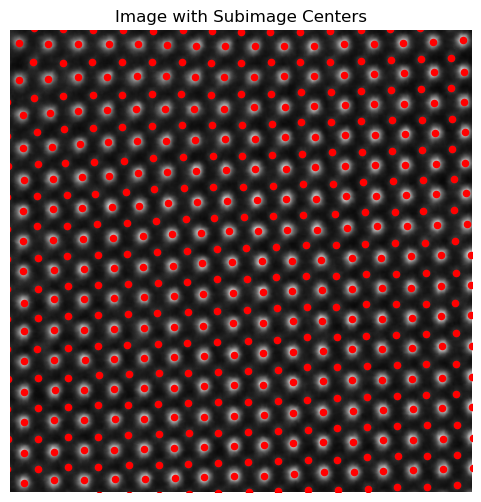

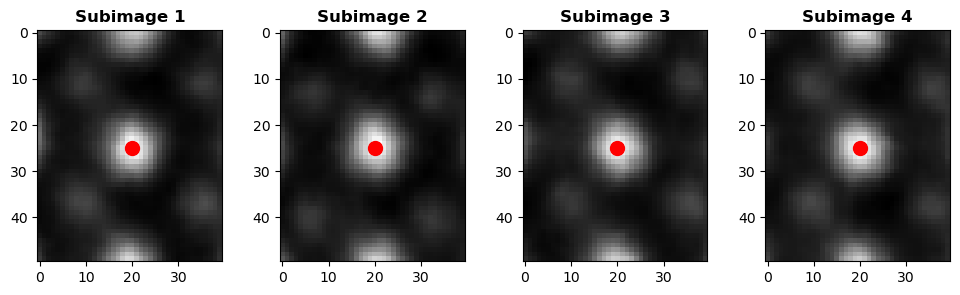

In [27]:
plt.figure(figsize=(6, 6))
plt.imshow(image, cmap='gray')
plt.scatter(coms_target[:, 1], coms_target[:, 0], c='r', marker='o', s = 20
            )
plt.axis('off')
plt.title('Image with Subimage Centers')
plt.xlim([300, 700])
plt.ylim([300, 700])
plt.show()

# Plot a few example subimages with their centers
fig, axes = plt.subplots(1, 4, figsize=(12, 3))
for i, ax in enumerate(axes):
    ax.imshow(subimages_target[i], cmap='gray')
    ax.scatter(window_size[1] // 2, window_size[0] // 2, c='r', marker='o', s = 100)
    ax.set_title(f'Subimage {i+1}', fontweight = "bold")
plt.show()

Average descriptor of all subimages

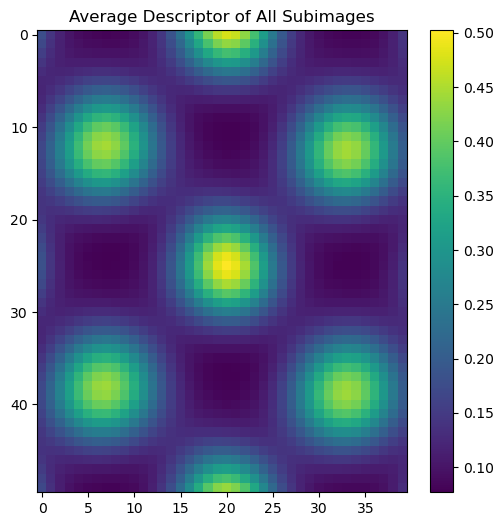

In [28]:
# Calculate and visualize the average descriptor
average_descriptor = descriptors.mean(axis=0).reshape(window_size)
plt.figure(figsize=(6, 6))
plt.imshow(average_descriptor, cmap='viridis')
plt.colorbar()
plt.title("Average Descriptor of All Subimages")
# plt.axis('off')
plt.show()

## GMM clustering

Here, we’re applying clustering to the descriptors extracted from subimages to group similar structural features and then visualizing the clusters to better understand the patterns in the data.

Clustering with Gaussian Mixture Model (GMM)
1. **GMM on Raw Descriptors (Fit_GMM)**:

    The function Fit_GMM is applied directly to the descriptors, with 5 clusters specified and a "full" covariance type. This model assumes the data can be represented by a mixture of 5 Gaussian distributions with unrestricted covariance matrices (i.e., allowing each cluster to have its unique shape).

    Outputs:
    labels: Cluster labels assigned to each subimage, indicating the group each subimage belongs to.

    valid_subimages: The subset of descriptors that were successfully clustered.
2. **PCA and GMM Combined (Fit_PCA_GMM)**:

    The Fit_PCA_GMM function applies Principal Component Analysis (PCA) to reduce the dimensionality of the descriptors from high-dimensional space down to 2 principal components (PCs).

In [29]:
labels, valid_subimages  = Fit_GMM(descriptors, 5, "full")

In [30]:
labels_pca, reduced_data_pca  = Fit_PCA_GMM(descriptors, 2, 5, "full")

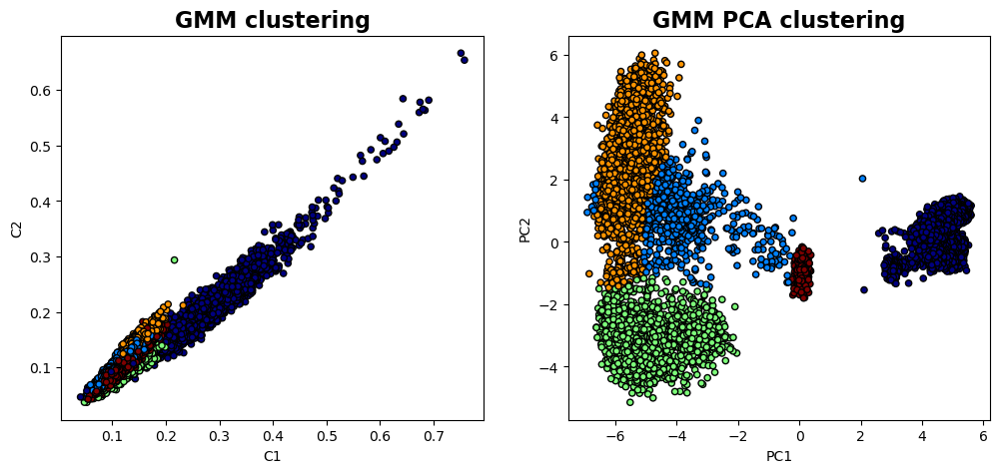

In [31]:
fig , axes = plt.subplots(1, 2 , figsize = (12, 5))

axes[0].scatter(valid_subimages[:, 0], valid_subimages[:, 1], c=labels, s=20, cmap='jet', edgecolor='k')
axes[0].set_title('GMM clustering' , fontsize = 16, fontweight = "bold")
axes[0].set_xlabel('C1')
axes[0].set_ylabel('C2')

axes[1].scatter(reduced_data_pca[:, 0], reduced_data_pca[:, 1], c=labels_pca, s=20, cmap='jet', edgecolor='k')
axes[1].set_title('GMM PCA clustering' , fontsize = 16, fontweight = "bold")
axes[1].set_xlabel('PC1')
axes[1].set_ylabel('PC2')

plt.show()

GMM Clustering on Raw Descriptors: Shows how the data clusters naturally in the full feature space, revealing groups based on subtle structural differences.

PCA-Reduced Clustering: Highlights patterns in the data's most significant variance directions, simplifying the feature space and often revealing clearer group separations.

The visualization below depicts the centroids and dispersions of clusters, providing insights into their central tendencies and variability.
* The centroids, representing the mean values of descriptors within each cluster, highlight key features distinct to each cluster.
* The dispersions illustrate the standard deviations of the descriptors, indicating the degree of variability among cluster members. Together, these visualizations reveal both the characteristic features and the stability of each cluster.

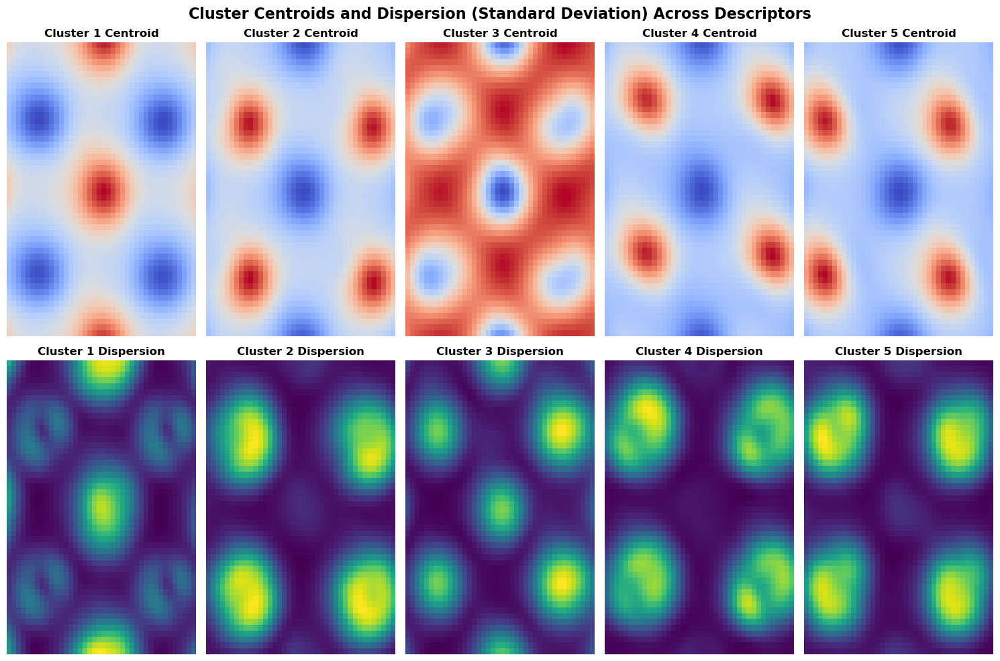

In [32]:
# Initialize lists to store the centroids and dispersions
cluster_centroids = []
cluster_dispersions = []

# Calculate the overall mean descriptor
overall_mean = descriptors.mean(axis=0)

# Calculate the centroids and dispersions for each cluster
for cluster_label in np.unique(labels):
    # Get descriptors for the current cluster
    cluster_descriptors = descriptors[labels == cluster_label]
    # Calculate centroid and dispersion (standard deviation) for each cluster
    centroid = cluster_descriptors.mean(axis=0) - overall_mean
    dispersion = cluster_descriptors.std(axis=0)
    # Append results
    cluster_centroids.append(centroid)
    cluster_dispersions.append(dispersion)

# Convert to NumPy arrays for easy handling
cluster_centroids = np.array(cluster_centroids)
cluster_dispersions = np.array(cluster_dispersions)

# Plot the centroids and dispersions
fig, axes = plt.subplots(2, len(cluster_centroids), figsize=(15, 10))

# First row: Cluster centroids (centered)
for i, ax in enumerate(axes[0]):
    centroid_image = cluster_centroids[i].reshape(window_size)
    im_centroid = ax.imshow(centroid_image, cmap='coolwarm', aspect='auto')
    ax.set_title(f'Cluster {i+1} Centroid', fontweight="bold")
    ax.axis('off')

# Second row: Cluster dispersions (standard deviation within each cluster)
for i, ax in enumerate(axes[1]):
    dispersion_image = cluster_dispersions[i].reshape(window_size)
    im_dispersion = ax.imshow(dispersion_image, cmap='viridis', aspect='auto')
    ax.set_title(f'Cluster {i+1} Dispersion', fontweight="bold")
    ax.axis('off')

# # Add colorbars for interpretation
# fig.colorbar(im_centroid, ax=axes[0], orientation='vertical', fraction=0.02, pad=0.04)
# fig.colorbar(im_dispersion, ax=axes[1], orientation='vertical', fraction=0.02, pad=0.04)

plt.suptitle("Cluster Centroids and Dispersion (Standard Deviation) Across Descriptors", fontsize=16, fontweight="bold")
plt.tight_layout()
plt.show()

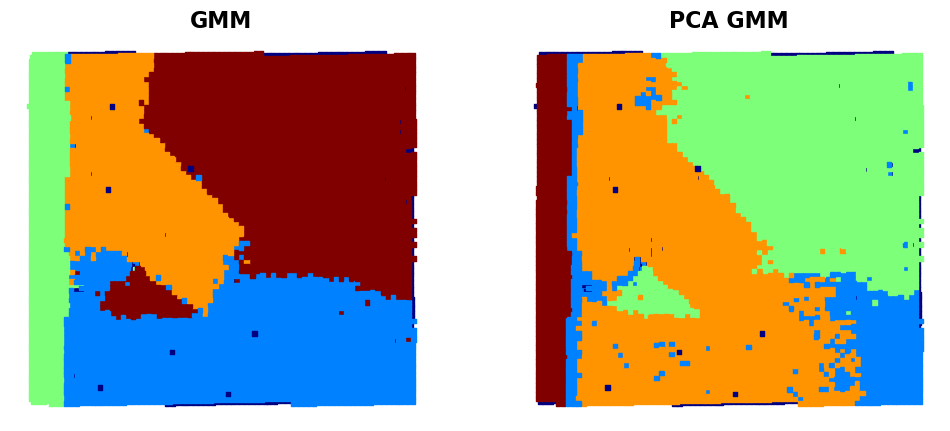

In [33]:
fig, ax = plt.subplots(1, 2, figsize=(12, 5))

# First subplot
ax[0].scatter(coms_target[:, 1], coms_target[:, 0], c=labels, s=10, cmap='jet', marker="s")
ax[0].set_title('GMM' , fontsize = 16, fontweight = "bold")
ax[0].axis('off')

ax[1].scatter(coms_target[:, 1], coms_target[:, 0], c=labels_pca, s=10, cmap='jet', marker="s")
ax[1].set_title('PCA GMM' , fontsize = 16, fontweight = "bold")
ax[1].axis('off')  # Just to leave it empty for now

plt.show()

In [130]:
# Interactive function for plotting
def interactive_gmm_pca(window_width, window_height):
    # Parameters
    window_size = (window_width, window_height)
    min_sigma = 1
    max_sigma = 5
    threshold = 0.025
    overlap = 0.0
    
    # Build descriptors and fit models
    descriptors, coms_target, _, _, _ = build_descriptor(window_size, min_sigma, max_sigma, threshold, overlap)
    labels, valid_subimages = Fit_GMM(descriptors, 5, "full")
    labels_pca, reduced_data_pca = Fit_PCA_GMM(descriptors, 2, 5, "full")
    
    # Create a 2x2 plot
    fig, axes = plt.subplots(2, 2, figsize=(12, 12))
    
    # GMM Clusters
    axes[0, 0].scatter(valid_subimages[:, 0], valid_subimages[:, 1], c=labels, s=20, cmap='jet', edgecolor='k')
    axes[0, 0].set_title('GMM Clusters', fontsize=16, fontweight="bold")
    axes[0, 0].set_xlabel('C1')
    axes[0, 0].set_ylabel('C2')

    # PCA Clusters
    axes[0, 1].scatter(reduced_data_pca[:, 0], reduced_data_pca[:, 1], c=labels_pca, s=20, cmap='jet', edgecolor='k')
    axes[0, 1].set_title('PCA GMM Clusters', fontsize=16, fontweight="bold")
    axes[0, 1].set_xlabel('PC1')
    axes[0, 1].set_ylabel('PC2')

    # GMM Final Maps
    axes[1, 0].scatter(coms_target[:, 1], coms_target[:, 0], c=labels, s=10, cmap='jet', marker="s")
    axes[1, 0].set_title('GMM Final Map', fontsize=16, fontweight="bold")
    axes[1, 0].axis('off')

    # PCA Final Maps
    axes[1, 1].scatter(coms_target[:, 1], coms_target[:, 0], c=labels_pca, s=10, cmap='jet', marker="s")
    axes[1, 1].set_title('PCA Final Map', fontsize=16, fontweight="bold")
    axes[1, 1].axis('off')

    # Adjust layout
    plt.tight_layout()
    plt.show()

In [131]:
#| label: app:example_widget_1
# Clusters and maps

import ipywidgets
ipywidgets.interact(interactive_gmm_pca, 
         window_width=widgets.IntSlider(min=2, max=64, step=2, value=2, description='Width'),
         window_height=widgets.IntSlider(min=2, max=64, step=2, value=2, description='Height'))

interactive(children=(IntSlider(value=2, description='Width', max=64, min=2, step=2), IntSlider(value=2, descr…

<function __main__.interactive_gmm_pca(window_width, window_height)>

As you can see, the use of the GMM clustering in the original descriptor space (i.e. 1600 dimensional space if the descriptor is 40x40 image patch) gives a pretty good separation of several domain configurations and substrate. The GMM clustering of the data set that was dimensionality reduced by PCA shows additional details - for example, you can see that the domain on the bottom is now split in two parts. Practically, it happens because the STEM imaging is not ideal, and the image suffers from mis-tilt effect (small deviation of the column direction from the beam direction). Npte that this mistilt effect is not visible on the polarization field maps. So we can start asking questions like:
- What is the "right" way to analyze the data?
- What other information on materials properties is hidden in the images?
- And how can we extract it combining both the data-driven and physical insights?

Let's explore this using the VAE approaches!


## VAE

Now, let's explore our imaging data using the simple VAE.

The Variational Autoencoder (VAE) is a type of deep generative model that can learn to encode high-dimensional data, such as images, into a low-dimensional latent space and then decode that latent representation back to the original data space. A VAE is particularly useful in imaging data, as it can capture meaningful features in a compressed form, making it easier to analyze patterns, generate new images, or explore variations in the data.

**What Does a Simple VAE Do?**
* Encoder:

    The encoder maps the input image into a latent space by compressing it into a lower-dimensional representation.
    Unlike a traditional autoencoder, which might produce a fixed vector, the VAE encoder outputs two components for each latent dimension: a mean and a log variance. These parameters define a Gaussian distribution over the latent space for each input.

* Latent Space Sampling:

    After the encoder produces a mean and variance, a sample is drawn from this Gaussian distribution, which allows the VAE to introduce some randomness or variability into the latent representation.
    The sampling process makes the VAE a generative model, enabling it to create new images by sampling different points in the latent space.

* Decoder:

    The sampled latent vector is then fed to the decoder, which reconstructs the image.
    The decoder tries to reproduce the original input as accurately as possible, allowing the VAE to learn a compressed, yet informative, representation of the input data.
* Loss Function:

    The VAE optimizes two components:
    Reconstruction Loss: Measures the similarity between the input image and the reconstructed image, encouraging the VAE to accurately capture image details.
    KL Divergence: Regularizes the latent space, ensuring the learned latent distributions are close to a standard Gaussian. This keeps the latent space smooth, meaning that similar points in the latent space correspond to similar reconstructed images.

First, let's prepare the data:

In [34]:
#normalize imagestack
subimages_target = subimages_target/subimages_target.max()
subimages_target = np.expand_dims(subimages_target, axis=-1)
train_data = torch.tensor(subimages_target[:,:,:,0]).float()
train_loader = pv.utils.init_dataloader(train_data.unsqueeze(1), batch_size=48, seed=0)

Now, running the VAE in PyroVEd. Simple VAE will find the best representation of our data as two components for latent vecotr (l1,l2). Of course, we can explore other dimensinalities of latent space!

In [35]:
in_dim = (window_size[0],window_size[1])

# Initialize vanilla VAE
vae = pv.models.iVAE(in_dim, latent_dim=2,   # Number of latent dimensions other than the invariancies
                     hidden_dim_e = [512, 512],
                     hidden_dim_d = [512, 512], # corresponds to the number of neurons in the hidden layers of the decoder
                     invariances=None, seed=0)
# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(vae)

# Train for n epochs:
for e in range(10):
    trainer.step(train_loader)
    trainer.print_statistics()

Epoch: 1 Training loss: 877.0379
Epoch: 2 Training loss: 837.0261
Epoch: 3 Training loss: 835.4939
Epoch: 4 Training loss: 834.9074
Epoch: 5 Training loss: 834.6070
Epoch: 6 Training loss: 834.2519
Epoch: 7 Training loss: 834.0762
Epoch: 8 Training loss: 833.9149
Epoch: 9 Training loss: 833.6475
Epoch: 10 Training loss: 833.9551


Varitional Auto Encoder manifold representation

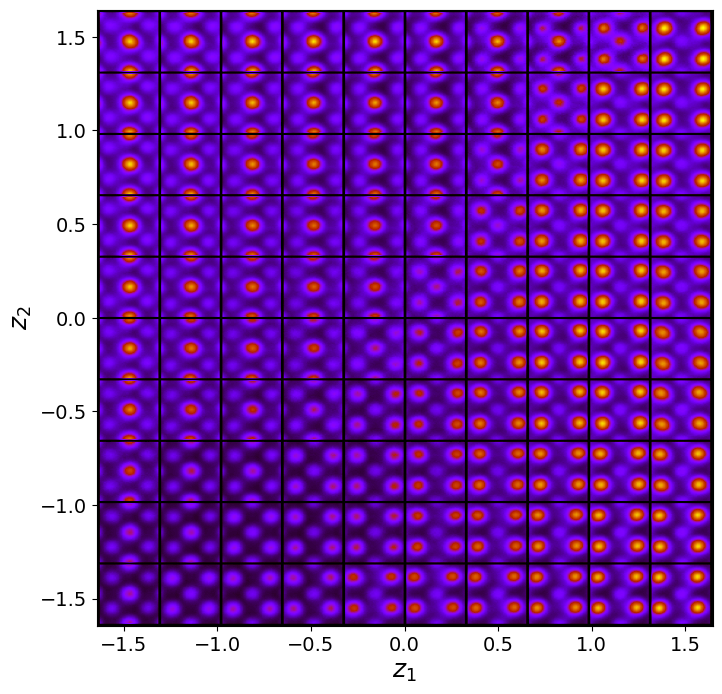

In [40]:
vae_laten_img = vae.manifold2d(d=10, draw_grid = True, origin = 'lower')

The latent representation of the system is visualized as a grid over the two latent variables $z_1$ and $z_2$. Each grid cell corresponds to a unique combination of values for $z_1$ and $z_2$ , which are decoded to produce corresponding reconstructions in the data space. The smooth and structured transition across the grid indicates that the model has learned a meaningful and continuous mapping between the latent variables and the data space. Variations in the grid reflect changes in the underlying physical structure, such as column type, domain orientation, or material properties.

In [41]:
vae_z_mean, vae_z_sd = vae.encode(train_data)
z1 = vae_z_mean[:, -2]
z2 = vae_z_mean[:, -1]

Latent representation

In [45]:
from scipy.stats import gaussian_kde

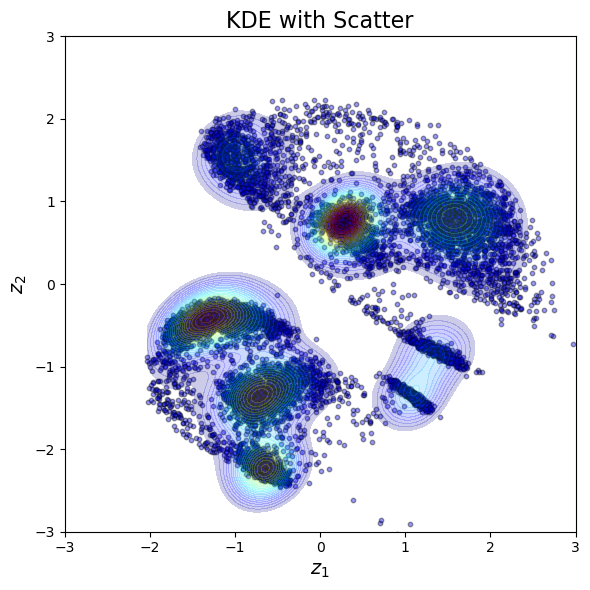

In [191]:
fig, ax = plt.subplots(figsize=(6, 6))
kde = gaussian_kde([z1, z2])
x, y = np.linspace(min(z1), max(z1), 200), np.linspace(min(z2), max(z2), 200)
X, Y = np.meshgrid(x, y)
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
levels = np.linspace(Z.min() + 0.1 * (Z.max() - Z.min()), Z.max(), 30)

ax.scatter(z1, z2, c="b", s=10, alpha=0.4, edgecolors="k")
ax.contourf(X, Y, Z, levels=levels, cmap="jet", alpha=0.2)
ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)
ax.set_title("KDE with Scatter", fontsize=16)
ax.set_xlabel(r"$z_1$", fontsize=14)
ax.set_ylabel(r"$z_2$", fontsize=14)

plt.tight_layout()
plt.show()

In [192]:
def generate_latent_manifold(n=10, decoder=None, target_size=(28, 28)):
    """
    Generate a general latent manifold grid over the entire latent space.
    """
    # Define grid bounds across latent space
    grid_x = np.linspace(min(z1), max(z1), n)
    grid_y = np.linspace(min(z2), max(z2), n)

    # Dynamically infer output shape
    sample_input = torch.tensor([[grid_x[0], grid_y[0]]], dtype=torch.float32)
    with torch.no_grad():
        X_decoded = decoder(sample_input)
    decoded_shape = X_decoded.shape[-2:] if len(X_decoded.shape) > 2 else (X_decoded.shape[-1], X_decoded.shape[-1])

    height, width = target_size
    manifold = np.zeros((height * n, width * n))

    # Generate manifold
    for i, yi in enumerate(grid_x):
        for j, xi in enumerate(grid_y):
            Z_sample = torch.tensor([[xi, yi]], dtype=torch.float32)
            with torch.no_grad():
                X_decoded = decoder(Z_sample).reshape(decoded_shape)
            resized_image = zoom(X_decoded, zoom=(height / X_decoded.shape[-2], width / X_decoded.shape[-1]))
            manifold[i * height: (i + 1) * height, j * width: (j + 1) * width] = resized_image
    return manifold

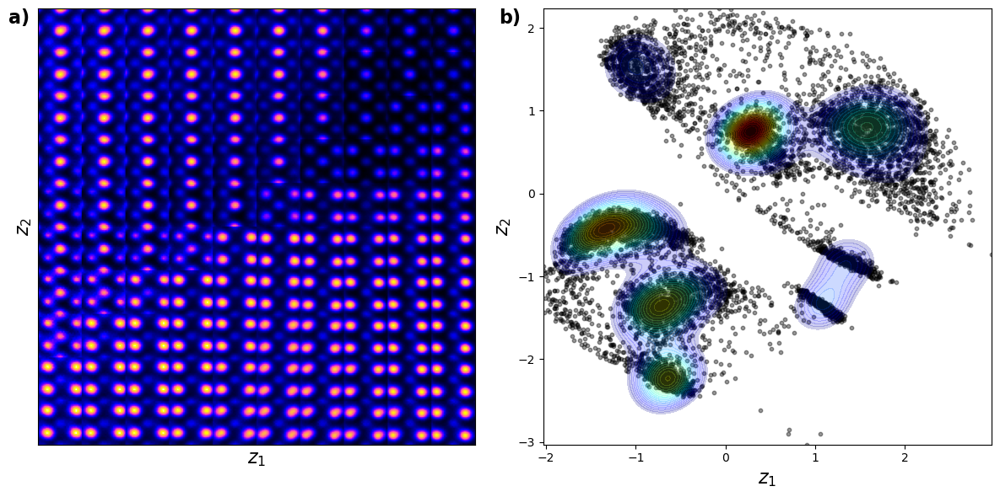

In [197]:
#| label: app:VAE_figure1
# VAE_manifold_1

fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Generate and plot latent manifold
manifold = generate_latent_manifold(n=10, decoder=vae.decode, target_size=(28, 28))
axes[0].imshow(manifold, cmap="gnuplot2", origin="upper")

axes[0].set_xlabel(r"$z_1$", fontsize=16)
axes[0].set_ylabel(r"$z_2$", fontsize=16)
axes[0].set_xticks([])
axes[0].set_yticks([])

# Add "a)" to the first subplot
axes[0].text(-0.02, 1, 'a)', transform=axes[0].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# KDE with adjusted levels
kde = gaussian_kde([z1, z2])
x, y = np.linspace(min(z1), max(z1), 200), np.linspace(min(z2), max(z2), 200)
X, Y = np.meshgrid(x, y)
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
levels = np.linspace(Z.min() + 0.2 * (Z.max() - Z.min()), Z.max(), 30)

axes[1].scatter(z1, z2, c="black", s=10, alpha=0.4, edgecolors="k")
axes[1].contourf(X, Y, Z, levels=levels, cmap="jet", alpha=0.2)

axes[1].set_xlabel(r"$z_1$", fontsize=16)
axes[1].set_ylabel(r"$z_2$", fontsize=16)

# Add "b)" to the second subplot
axes[1].text(-0.05, 1, 'b)', transform=axes[1].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

plt.tight_layout()
plt.show()

Shown above is the latent distirbution of the system  

You can see selveral clusters in the latent space. These correspond to the column type (the primary factor of variation), ferroelectric domain orientation, and nature of material (BFO or substarte). Note that in this case **all** fatcors of variation are rperesented via just two latent variables.

Now, let's explore the latent maps. Remember that each column have become two latent variables, so we can plot them in real space.

In [195]:
# Replace with your actual data
z1 = z1  # Latent variable 1
z2 = z2  # Latent variable 2
Px = SBFOdata[0]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]]  # Ground truth Px
Py = SBFOdata[0]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]]  # Ground truth Py
coms_target = coms_target  # Coordinates for scatter plots

# List of options
options = ["z1", "z2", "Ground Truth Px", "Ground Truth Py"]

# Function to plot two selected variables
def plot_two_variables(variable1, variable2):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Plot for variable 1
    if variable1 == "z1":
        axes[0].scatter(coms_target[:, 1], coms_target[:, 0], c=z1, s=14, cmap='jet', marker="o")
        axes[0].set_title("Latent Variable z1", fontsize=16)
    elif variable1 == "z2":
        axes[0].scatter(coms_target[:, 1], coms_target[:, 0], c=z2, s=14, cmap='jet', marker="o")
        axes[0].set_title("Latent Variable z2", fontsize=16)
    elif variable1 == "Ground Truth Px":
        axes[0].imshow(Px, cmap='jet', origin='lower')
        axes[0].set_title("Ground Truth Px", fontsize=16)
    elif variable1 == "Ground Truth Py":
        axes[0].imshow(Py, cmap='jet', origin='lower')
        axes[0].set_title("Ground Truth Py", fontsize=16)
    
    axes[0].axis("off")
    
    # Plot for variable 2
    if variable2 == "z1":
        axes[1].scatter(coms_target[:, 1], coms_target[:, 0], c=z1, s=14, cmap='jet', marker="o")
        axes[1].set_title("Latent Variable z1", fontsize=16)
    elif variable2 == "z2":
        axes[1].scatter(coms_target[:, 1], coms_target[:, 0], c=z2, s=14, cmap='jet', marker="o")
        axes[1].set_title("Latent Variable z2", fontsize=16)
    elif variable2 == "Ground Truth Px":
        axes[1].imshow(Px, cmap='jet', origin='lower')
        axes[1].set_title("Ground Truth Px", fontsize=16)
    elif variable2 == "Ground Truth Py":
        axes[1].imshow(Py, cmap='jet', origin='lower')
        axes[1].set_title("Ground Truth Py", fontsize=16)
    
    axes[1].axis("off")
    
    plt.tight_layout()
    plt.show()

In [133]:
#| label: app:VAE_figure_3
# Latent_maps_1

import ipywidgets
ipywidgets.interact(plot_two_variables, 
         variable1=widgets.Dropdown(options=options, description="Variable 1"), 
         variable2=widgets.Dropdown(options=options, description="Variable 2"))


interactive(children=(Dropdown(description='Variable 1', options=('z1', 'z2', 'Ground Truth Px', 'Ground Truth…

<function __main__.plot_two_variables(variable1, variable2)>

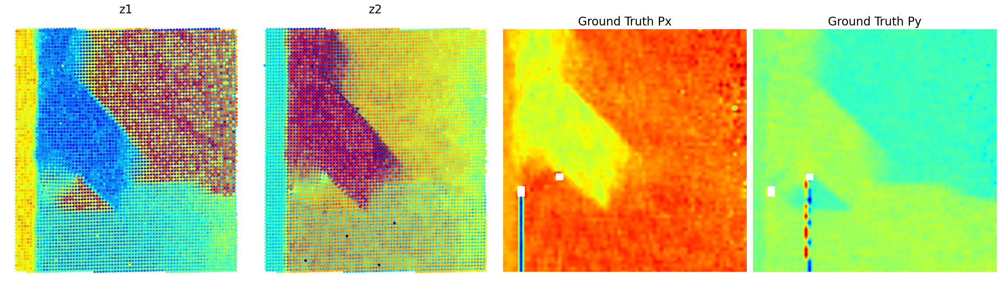

In [77]:

# Set up the figure with 1 row and 4 columns
fig, axes = plt.subplots(1, 4, figsize=(24, 7))

# Plot z1
axes[0].scatter(coms_target[:, 1], coms_target[:, 0], c=z1, s=14, cmap='jet', marker="o")
axes[0].set_title("z1", fontsize=20)
axes[0].axis("off")

# Plot z2
axes[1].scatter(coms_target[:, 1], coms_target[:, 0], c=z2, s=14, cmap='jet', marker="o")
axes[1].set_title("z2", fontsize=20)
axes[1].axis("off")

# Plot ground truth Px
axes[2].imshow(SBFOdata[0]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]], cmap='jet', origin='lower')
axes[2].set_title("Ground Truth Px", fontsize=20)
axes[2].axis("off")

# Plot ground truth Py
axes[3].imshow(SBFOdata[0]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]], cmap='jet', origin='lower')
axes[3].set_title("Ground Truth Py", fontsize=20)
axes[3].axis("off")

# Adjust layout for better spacing
plt.tight_layout()
plt.show()

Not bad! We can see that our VAE anaysis has visualzied the domains as different contrats level for the z1 and z2. We see the difference between the substarte and material, and on z2 image we see the mistilt effect that shows like gradient towards the r.h.s. of the image.

However, this analysis has two big problems:
- the latent variables do not have defined physical meaning. To be more precide, we can interpret them with the latent representation, but that's pretty much it.
- How do we know how many latent variable to choose?

## rVAE

Now, let's experiment with rotationally invariant VAE. Here, we try to encode the data as latent vecotr and rotation vecotr. Whereas latent variables attempt to represent the intirnsic facotrs of variation, rotation has a well defined physical meaning. SO if we choose the rVAE with 2D latent space, we effectively have 3 latent variables - 2 regular and one that encodes the orientation of out descriptor. We have started to learn physics!

In [199]:
in_dim = (window_size[0],window_size[1])

# Initialize vanilla VAE
rvae = pv.models.iVAE(in_dim, latent_dim=2,   # Number of latent dimensions other than the invariancies
                     hidden_dim_e = [512, 512],
                     hidden_dim_d = [512, 512], # corresponds to the number of neurons in the hidden layers of the decoder
                     invariances=["r"], seed=0)
# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(rvae)

# Train for n epochs:
for e in range(10):
    trainer.step(train_loader)
    trainer.print_statistics()

KeyboardInterrupt: 

Varitional Auto Encoder manifold representation

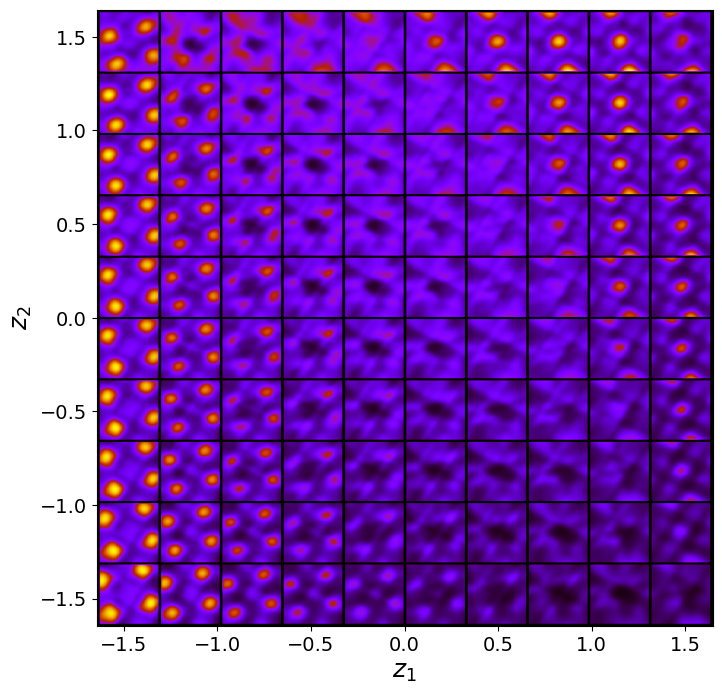

In [62]:
rvae_laten_img = rvae.manifold2d(d=10, draw_grid = True, origin = 'lower')

In [61]:
rvae_z_mean, rvae_z_sd = rvae.encode(train_data)
z1 = rvae_z_mean[:, -2]
z2 = rvae_z_mean[:, -1]
ang = rvae_z_mean[:, 0]

Latent representation

NameError: name 'sns' is not defined

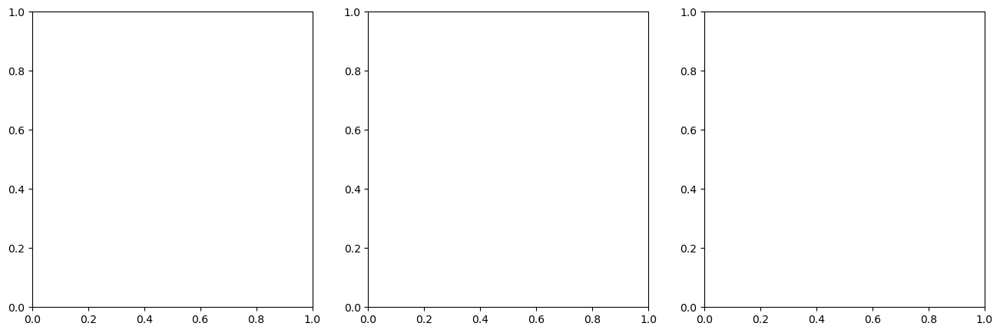

In [63]:
fig, axes = plt.subplots(1, 3, figsize=(16, 5))

# First plot: z1 vs. z2 with KDE
sns.kdeplot(x=z1, y=z2, ax=axes[0], cmap='Spectral', fill=True, alpha=0.4, levels=10)
axes[0].scatter(z1, z2, c="b", s=20, alpha=0.7, edgecolors="k")
axes[0].set_xlabel("z1", fontsize=20)
axes[0].set_ylabel("z2", fontsize=20)
axes[0].set_xticks([])
axes[0].set_yticks([])

# Second plot: ang vs. z2 with KDE
sns.kdeplot(x=ang, y=z2, ax=axes[1], cmap='Spectral', fill=True, alpha=0.4, levels=10)
axes[1].scatter(ang, z2, c="b", s=20, alpha=0.7, edgecolors="k")
axes[1].set_xlabel("ang", fontsize=20)
axes[1].set_ylabel("z2", fontsize=20)
axes[1].set_xticks([])
axes[1].set_yticks([])

# Third plot: ang vs. z1 with KDE
sns.kdeplot(x=ang, y=z1, ax=axes[2], cmap='Spectral', fill=True, alpha=0.4, levels=10)
axes[2].scatter(ang, z1, c="b", s=20, alpha=0.7, edgecolors="k")
axes[2].set_xlabel("ang", fontsize=20)
axes[2].set_ylabel("z1", fontsize=20)
axes[2].set_xticks([])
axes[2].set_yticks([])

plt.tight_layout()
plt.show()


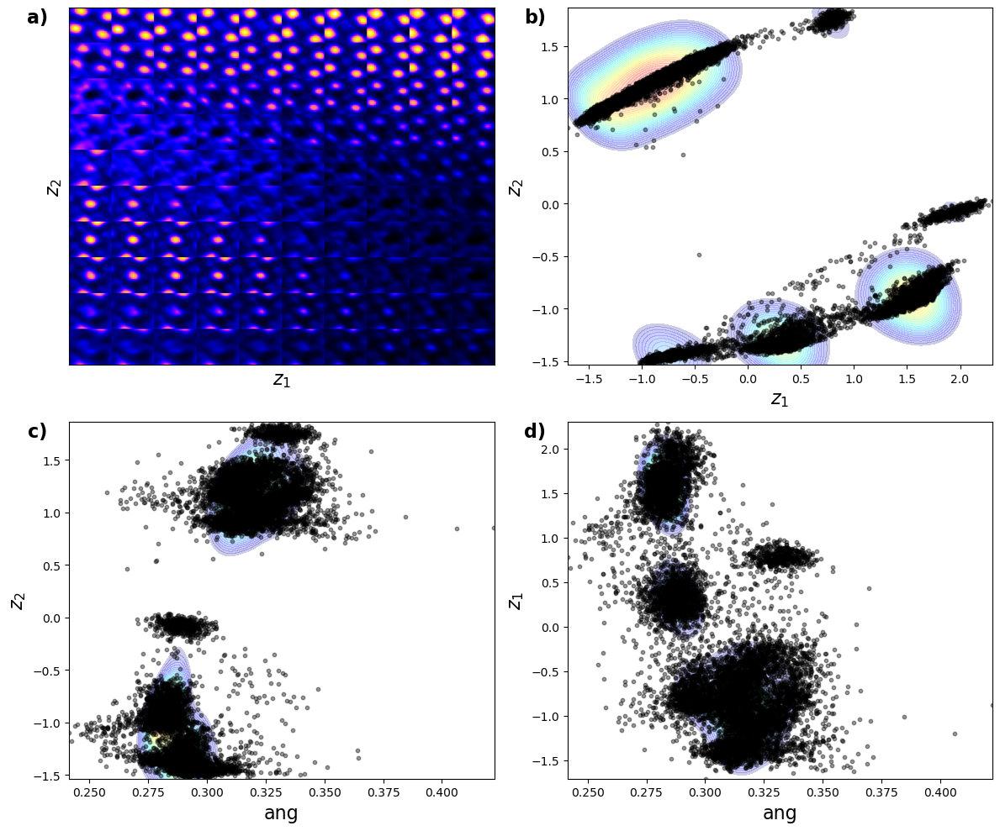

In [67]:
#| label: app:rVAE_widget_1
# fig_rVAE_widget_1

fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Define consistent axes limits
z1_lim = [min(z1), max(z1)]
z2_lim = [min(z2), max(z2)]
ang_lim = [min(ang), max(ang)]

# (a) Latent manifold
manifold = generate_latent_manifold(n=10, decoder=rvae.decode, target_size=(28, 28))
axes[0, 0].imshow(manifold, cmap="gnuplot2", origin="upper", aspect='auto')
axes[0, 0].set_xlabel(r"$z_1$", fontsize=16)
axes[0, 0].set_ylabel(r"$z_2$", fontsize=16)
axes[0, 0].set_xticks([]), axes[0, 0].set_yticks([])
axes[0, 0].text(-0.05, 1, 'a)', transform=axes[0, 0].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# (b) z1 vs z2 with KDE
kde = gaussian_kde([z1, z2])
X, Y = np.meshgrid(np.linspace(*z1_lim, 200), np.linspace(*z2_lim, 200))
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
levels = np.linspace(Z.min() + 0.2 * (Z.max() - Z.min()), Z.max(), 30)  # Explicit levels

axes[0, 1].contourf(X, Y, Z, levels=levels, cmap="jet", alpha=0.2)
axes[0, 1].scatter(z1, z2, c="black", s=10, alpha=0.4, edgecolors="k")
axes[0, 1].set_xlim(z1_lim), axes[0, 1].set_ylim(z2_lim)
axes[0, 1].set_xlabel(r"$z_1$", fontsize=16)
axes[0, 1].set_ylabel(r"$z_2$", fontsize=16)
axes[0, 1].text(-0.05, 1, 'b)', transform=axes[0, 1].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# (c) ang vs z2 with KDE
kde = gaussian_kde([ang, z2])
X, Y = np.meshgrid(np.linspace(*ang_lim, 200), np.linspace(*z2_lim, 200))
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
levels = np.linspace(Z.min() + 0.2 * (Z.max() - Z.min()), Z.max(), 30)

axes[1, 0].contourf(X, Y, Z, levels=levels, cmap="jet", alpha=0.2)
axes[1, 0].scatter(ang, z2, c="black", s=10, alpha=0.4, edgecolors="k")
axes[1, 0].set_xlim(ang_lim), axes[1, 0].set_ylim(z2_lim)
axes[1, 0].set_xlabel("ang", fontsize=16)
axes[1, 0].set_ylabel(r"$z_2$", fontsize=16)
axes[1, 0].text(-0.05, 1, 'c)', transform=axes[1, 0].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# (d) ang vs z1 with KDE
kde = gaussian_kde([ang, z1])
X, Y = np.meshgrid(np.linspace(*ang_lim, 200), np.linspace(*z1_lim, 200))
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
levels = np.linspace(Z.min() + 0.2 * (Z.max() - Z.min()), Z.max(), 30)

axes[1, 1].contourf(X, Y, Z, levels=levels, cmap="jet", alpha=0.2)
axes[1, 1].scatter(ang, z1, c="black", s=10, alpha=0.4, edgecolors="k")
axes[1, 1].set_xlim(ang_lim), axes[1, 1].set_ylim(z1_lim)
axes[1, 1].set_xlabel("ang", fontsize=16)
axes[1, 1].set_ylabel(r"$z_1$", fontsize=16)
axes[1, 1].text(-0.05, 1, 'd)', transform=axes[1, 1].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# Adjust layout and display
plt.tight_layout()
plt.show()



Now, the clusters in latent space become more separated. These clearly correspond to the A- and B type cations now.

In [72]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import ipywidgets as widgets
from ipywidgets import interact

# Define the data
z1 = z1  # Latent variable 1
z2 = z2  # Latent variable 2
ang = ang  # Angular variable
Px = SBFOdata[0]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]]  # Ground truth Px
Py = SBFOdata[0]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]]  # Ground truth Py

coms_target = coms_target  # Coordinates for scatter plots

# Define options and data dictionary
options = ["z1", "z2", "ang", "Ground Truth Px", "Ground Truth Py"]
data_dict = {
    "z1": z1,
    "z2": z2,
    "ang": ang,
    "Ground Truth Px": Px,
    "Ground Truth Py": Py
}

# Interactive function for plotting two selected variables
def interactive_plot(variable1, variable2):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Plot for variable 1
    values1 = data_dict[variable1]
    if variable1 in ["z1", "z2", "ang"]:
        scatter = axes[0].scatter(coms_target[:, 1], coms_target[:, 0], c=values1, s=10, cmap='jet', marker="s")
    else:
        im = axes[0].imshow(values1, cmap='jet', origin='lower')
    axes[0].set_title(variable1, fontsize=16)
    axes[0].axis("off")

    # Plot for variable 2
    values2 = data_dict[variable2]
    if variable2 in ["z1", "z2", "ang"]:
        scatter = axes[1].scatter(coms_target[:, 1], coms_target[:, 0], c=values2, s=10, cmap='jet', marker="s")
    else:
        im = axes[1].imshow(values2, cmap='jet', origin='lower')
    axes[1].set_title(variable2, fontsize=16)
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()


In [ ]:
#| label: app:rVAE_widget_2
# fig_rVAE_widget_2

ipywidgets.interact(interactive_plot,
         variable1=widgets.Dropdown(options=options, description="Variable 1"),
         variable2=widgets.Dropdown(options=options, description="Variable 2"));


interactive(children=(Dropdown(description='Variable 1', options=('z1', 'z2', 'ang', 'Ground Truth Px', 'Groun…

Latent maps

In [74]:


# data = [
#     (z1, "z1"),
#     (z2, "z2"),
#     (ang, "ang"),
#     (SBFOdata[1]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Px"),
#     (SBFOdata[1]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Py")
# ]

# # Set up the figure with 2 rows and 3 columns (since we have 5 datasets to plot)
# fig, axes = plt.subplots(2, 3, figsize=(16, 10))

# # Flatten the axes array for easier looping
# axes = axes.flatten()

# # Loop through data and plot each in the respective subplot
# for i, (values, title) in enumerate(data):
#     if i < 3:  # Plotting latent variables (z1, z2, ang) using scatter plot
#         scatter = axes[i].scatter(coms_target[:, 1], coms_target[:, 0], c=values, s=10, cmap='jet', marker="s")
#     else:  # Plotting Ground Truth Px and Py using imshow
#         im = axes[i].imshow(values, cmap='jet', origin='lower')

#     # Set title and turn off axis
#     axes[i].set_title(title, fontsize=20)
#     axes[i].axis("off")

# # Hide the unused subplot to avoid any empty map
# axes[-1].set_visible(False)

# # Adjust layout for better spacing
# plt.tight_layout()

# # Show the plot
# plt.show()


Now, we are starting ot see beautiful result - the domain walls are clearly associated with the rotation of th eunit cells. Note that we have positive and negative walls. So, we are leanring osmething!

## tVAE

Now. let's try the tarnslational VAE. Here, we effectively have intrincic latent variables and in addition two components of the translation vector (tx, ty), so our latent space is N+2 dimensional.

In [75]:
in_dim = (window_size[0],window_size[1])

# Initialize vanilla VAE
tvae = pv.models.iVAE(in_dim, latent_dim=2,   # Number of latent dimensions other than the invariancies
                     hidden_dim_e = [512, 512],
                     hidden_dim_d = [512, 512], # corresponds to the number of neurons in the hidden layers of the decoder
                     invariances=["t"], seed=0)
# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(tvae)

# Train for n epochs:
for e in range(10):
    trainer.step(train_loader)
    trainer.print_statistics()

Epoch: 1 Training loss: 964.7535
Epoch: 2 Training loss: 922.4348
Epoch: 3 Training loss: 892.8260
Epoch: 4 Training loss: 857.2786
Epoch: 5 Training loss: 844.8231
Epoch: 6 Training loss: 842.5403
Epoch: 7 Training loss: 841.3137
Epoch: 8 Training loss: 844.9952
Epoch: 9 Training loss: 840.4231
Epoch: 10 Training loss: 839.5939


Varitional Auto Encoder manifold representation

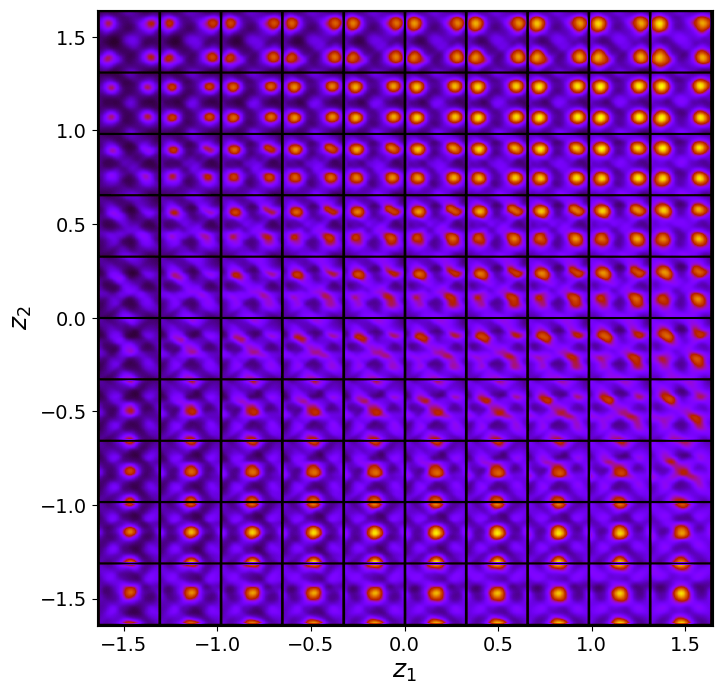

In [76]:
tvae_laten_img = tvae.manifold2d(d=10, draw_grid = True, origin = 'lower')

In [77]:
tvae_z_mean, tvae_z_sd = tvae.encode(train_data)
print('no. of defects', tvae_z_mean.shape)

z1 = tvae_z_mean[:, -2]
z2 = tvae_z_mean[:, -1]
tx = tvae_z_mean[:, -4]
ty = tvae_z_mean[:, -3]

no. of defects torch.Size([10917, 4])


Latent representation

In [ ]:
# combinations = [
#     (z1, z2, "z1", "z2"),
#     (z1, tx, "z1", "tx"),
#     (z1, ty, "z1", "ty"),
#     (z2, tx, "z2", "tx"),
#     (z2, ty, "z2", "ty"),
#     (tx, ty, "tx", "ty"),
# ]

# # Set up the figure with 2 rows and 3 columns
# fig, axes = plt.subplots(2, 3, figsize=(16, 10))

# # Flatten the axes array to loop through easily
# axes = axes.flatten()

# # Loop through combinations and plot them
# for i, (x, y, xlabel, ylabel) in enumerate(combinations):
#     # Plot KDE first
#     sns.kdeplot(x=x, y=y, fill=True, ax=axes[i], cmap='Spectral', alpha=0.4, levels=10)

#     # Scatter plot on top of KDE
#     axes[i].scatter(x, y, c="b", s=20, alpha=0.6, edgecolors="k")

#     # Set labels and axis properties
#     axes[i].set_xlabel(xlabel, fontsize=18)
#     axes[i].set_ylabel(ylabel, fontsize=18)
#     axes[i].set_xticks([])
#     axes[i].set_yticks([])

# # Adjust layout for better spacing
# plt.tight_layout()
# plt.show()

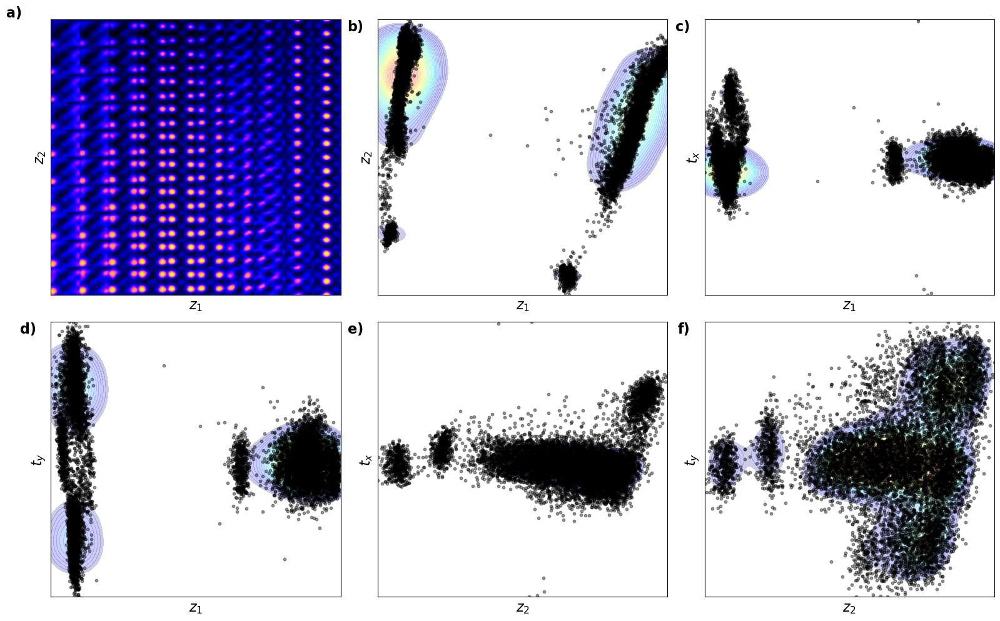

In [80]:
#| label: app:tVAE_widget_1
# fig_tVAE_widget_1

z1_lim = [min(z1), max(z1)]
z2_lim = [min(z2), max(z2)]
tx_lim = [min(tx), max(tx)]
ty_lim = [min(ty), max(ty)]

# Define combinations for KDE scatter plots
combinations = [
    (z1, z2, r"$z_1$", r"$z_2$"),   # (b)
    (z1, tx, r"$z_1$", r"$t_x$"),   # (c)
    (z1, ty, r"$z_1$", r"$t_y$"),   # (d)
    (z2, tx, r"$z_2$", r"$t_x$"),   # (e)
    (z2, ty, r"$z_2$", r"$t_y$")    # (f)
]

# Create figure with 2 rows and 3 columns
fig, axes = plt.subplots(2, 3, figsize=(16, 10))
axes = axes.flatten()  # Flatten axes for easier looping

# (a) Latent manifold plot in the first position
manifold = generate_latent_manifold(n=10, decoder=tvae.decode, target_size=(28, 28))
axes[0].imshow(manifold, cmap="gnuplot2", origin="upper", aspect="auto")
axes[0].set_xlabel(r"$z_1$", fontsize=16)
axes[0].set_ylabel(r"$z_2$", fontsize=16)
axes[0].set_xticks([]), axes[0].set_yticks([])
axes[0].text(-0.1, 1.05, 'a)', transform=axes[0].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# Loop through combinations and plot KDE with scatter plots
for i, (x, y, xlabel, ylabel) in enumerate(combinations):
    ax = axes[i + 1]  # Start from the second subplot

    # KDE plot
    kde = gaussian_kde([x, y])
    X, Y = np.meshgrid(np.linspace(min(x), max(x), 200), np.linspace(min(y), max(y), 200))
    Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
    levels = np.linspace(Z.min() + 0.2 * (Z.max() - Z.min()), Z.max(), 30)
    ax.contourf(X, Y, Z, levels=levels, cmap="jet", alpha=0.2)
    
    # Scatter plot on top
    ax.scatter(x, y, c="k", s=10, alpha=0.4, edgecolors="k")

    # Set labels, axis limits, and subplot labels
    ax.set_xlabel(xlabel, fontsize=16)
    ax.set_ylabel(ylabel, fontsize=16)
    ax.set_xlim(min(x), max(x)), ax.set_ylim(min(y), max(y))
    ax.set_xticks([]), ax.set_yticks([])
    ax.text(-0.05, 1, f'{chr(98 + i)})', transform=ax.transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# Adjust layout for better spacing
plt.tight_layout()
plt.show()

Now, th latent distribution start to look great. We see well defined clusters. It is tempting to say that these define the underpinning physics in the system.

In [84]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
import ipywidgets as widgets
from ipywidgets import interact

# Define the data
z1 = z1  # Latent variable 1
z2 = z2  # Latent variable 2
tx = tx  # Translation x
ty = ty  # Translation y
Px = SBFOdata[0]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]]  # Ground truth Px
Py = SBFOdata[0]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]]  # Ground truth Py
coms_target = coms_target  # Coordinates for scatter plots

# Define options and data dictionary
options = ["z1", "z2", "tx", "ty", "Ground Truth Px", "Ground Truth Py"]
data_dict = {
    "z1": z1,
    "z2": z2,
    "tx": tx,
    "ty": ty,
    "Ground Truth Px": Px,
    "Ground Truth Py": Py
}

# Interactive function for plotting any two selected variables
def interactive_plot(variable1, variable2):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Plot for variable 1
    values1 = data_dict[variable1]
    if variable1 in ["z1", "z2", "tx", "ty"]:
        axes[0].scatter(coms_target[:, 1], coms_target[:, 0], c=values1, s=10, cmap='jet', marker="s")
    else:
        axes[0].imshow(values1, cmap='jet', origin='lower')
    axes[0].set_title(variable1, fontsize=16)
    axes[0].axis("off")

    # Plot for variable 2
    values2 = data_dict[variable2]
    if variable2 in ["z1", "z2", "tx", "ty"]:
        axes[1].scatter(coms_target[:, 1], coms_target[:, 0], c=values2, s=10, cmap='jet', marker="s")
    else:
        axes[1].imshow(values2, cmap='jet', origin='lower')
    axes[1].set_title(variable2, fontsize=16)
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

In [85]:
#| label: app:tVAE_widget_2
# fig_tVAE_widget_2


ipywidgets.interact(
    interactive_plot,
    variable1=widgets.Dropdown(options=options, description="Variable 1"),
    variable2=widgets.Dropdown(options=options, description="Variable 2"),
);

interactive(children=(Dropdown(description='Variable 1', options=('z1', 'z2', 'tx', 'ty', 'Ground Truth Px', '…

Latent maps

In [ ]:
# # Create figure with subplots for the selected data points
# fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(16, 10))

# # Define the data to plot and corresponding titles for latent variables and selected regions
# data = [
#     (z1, "z1"),
#     (z2, "z2"),
#     (tx, "tx"),
#     (ty, "ty"),
#     (SBFOdata[1]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Px"),
#     (SBFOdata[1]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Py")
# ]

# # Flatten the axes array for easier looping
# axes = axes.flatten()

# # Loop through data, plot each in the respective subplot
# for i, (values, title) in enumerate(data):
#     if i < 4:  # Plotting z1, z2, tx, ty using scatter plot
#         scatter = axes[i].scatter(coms_target[:, 1], coms_target[:, 0], c=values, s=10, cmap='jet', marker="s")
#     else:  # Plotting Ground Truth Px and Py using imshow in selected region
#         im = axes[i].imshow(values, cmap='jet', origin='lower')

#     # Set title and turn off axis
#     axes[i].set_title(title, fontsize=20)
#     axes[i].axis("off")

# # Adjust layout for better spacing
# plt.tight_layout()

# # Show the plot
# plt.show()

Now, the latent maps are becoming super interetsing as well. Note that translation vectors look almost exactly like polarization components. Note that the physics of ferroelectric is effectively shifft of the cntral atom vs. corner - so the translation representation reflects it. At the same time, z1 and z2 ahow chemical contrast and mistilt effects, with a bit of leackage of the poalrization informaiton.

## trVAE

Now, let's try all invariances - translation and rotation.

In [86]:
in_dim = (window_size[0],window_size[1])

# Initialize vanilla VAE
trvae = pv.models.iVAE(in_dim, latent_dim=2,   # Number of latent dimensions other than the invariancies
                     hidden_dim_e = [512, 512],
                     hidden_dim_d = [512, 512], # corresponds to the number of neurons in the hidden layers of the decoder
                     invariances=["r", "t"], seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(trvae)

# Train for n epochs:
for e in range(10):
    trainer.step(train_loader)
    trainer.print_statistics()

Epoch: 1 Training loss: 974.0960
Epoch: 2 Training loss: 935.1682
Epoch: 3 Training loss: 911.7095
Epoch: 4 Training loss: 870.6058
Epoch: 5 Training loss: 851.1956
Epoch: 6 Training loss: 848.1778
Epoch: 7 Training loss: 846.5627
Epoch: 8 Training loss: 849.2985
Epoch: 9 Training loss: 845.2977
Epoch: 10 Training loss: 844.6232


Varitional Auto Encoder manifold representation

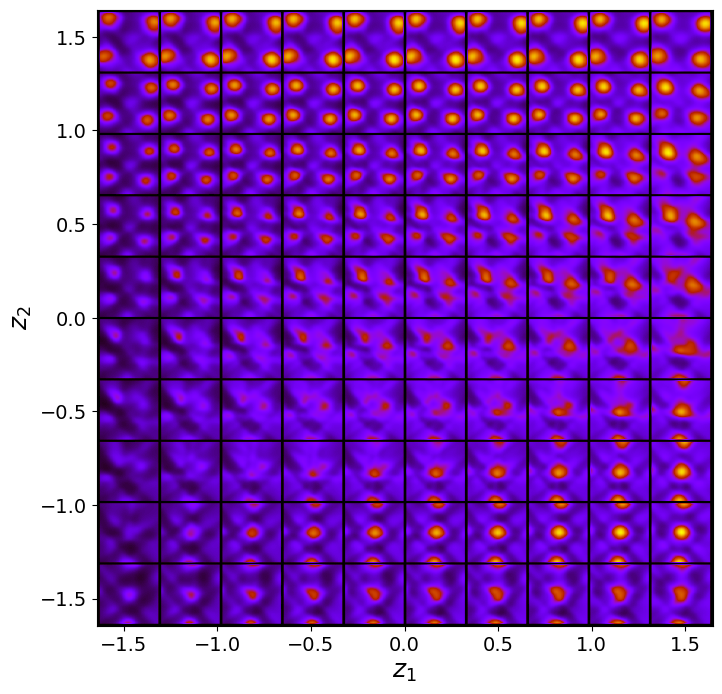

In [87]:
trvae_laten_img = trvae.manifold2d(d=10, draw_grid = True, origin = 'lower')

In [88]:
trvae_z_mean, trvae_z_sd = trvae.encode(train_data)
print('no. of defects', trvae_z_mean.shape)

z1 = trvae_z_mean[:, -2]
z2 = trvae_z_mean[:, -1]
ang = trvae_z_mean[:, 0]
tx = trvae_z_mean[:, -4]
ty = trvae_z_mean[:, -3]

no. of defects torch.Size([10917, 5])


Latent representation

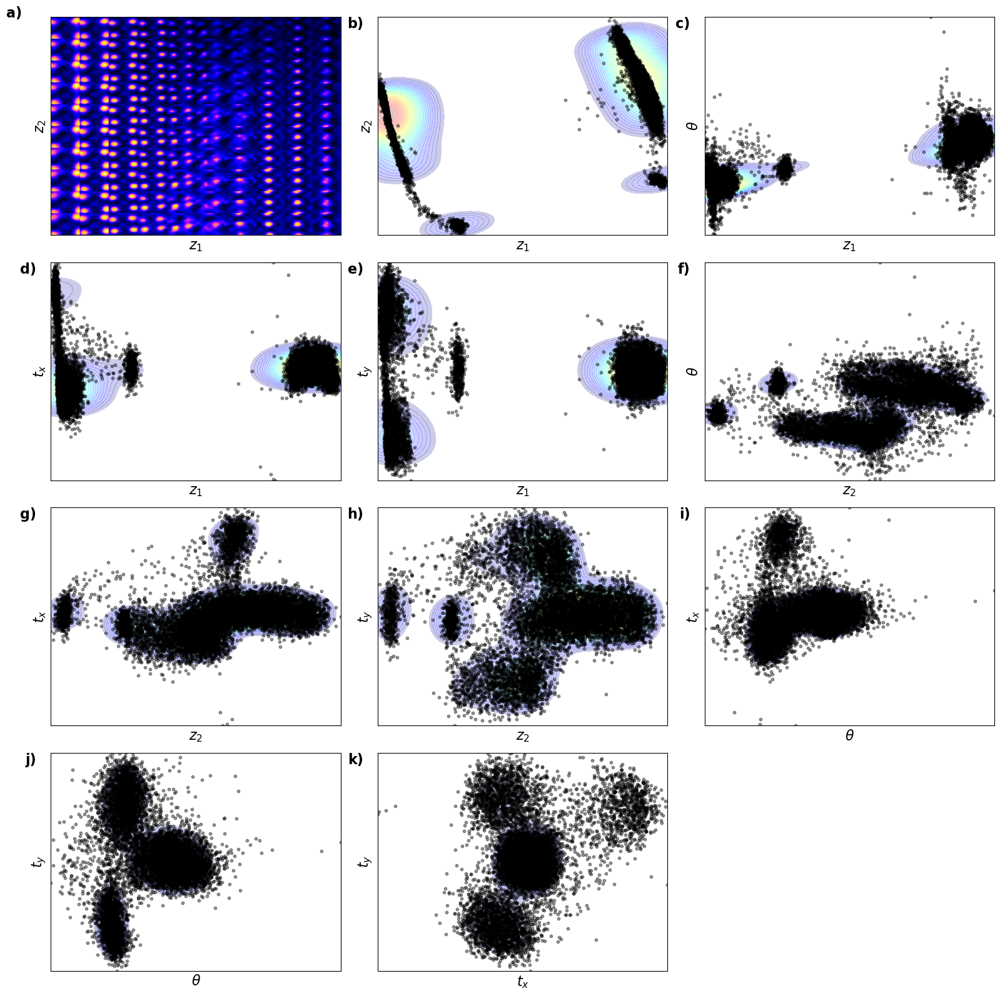

In [91]:
#| label: app:trVAE_widget_1
# fig_trVAE_widget_1

z1_lim = [min(z1), max(z1)]
z2_lim = [min(z2), max(z2)]
ang_lim = [min(ang), max(ang)]
tx_lim = [min(tx), max(tx)]
ty_lim = [min(ty), max(ty)]

# Define combinations for KDE scatter plots
combinations = [
    (z1, z2, r"$z_1$", r"$z_2$"),   # (b)
    (z1, ang, r"$z_1$", r"$\theta$"),   # (c)
    (z1, tx, r"$z_1$", r"$t_x$"),   # (d)
    (z1, ty, r"$z_1$", r"$t_y$"),   # (e)
    (z2, ang, r"$z_2$", r"$\theta$"),   # (f)
    (z2, tx, r"$z_2$", r"$t_x$"),   # (g)
    (z2, ty, r"$z_2$", r"$t_y$"),   # (h)
    (ang, tx, r"$\theta$", r"$t_x$"),   # (i)
    (ang, ty, r"$\theta$", r"$t_y$"),   # (j)
    (tx, ty, r"$t_x$", r"$t_y$")    # (k)
]

# Set up the figure with 4 rows and 3 columns
fig, axes = plt.subplots(4, 3, figsize=(16, 16))
axes = axes.flatten()  # Flatten axes for easy looping

# (a) Latent manifold plot in the first position
manifold = generate_latent_manifold(n=10, decoder=trvae.decode, target_size=(28, 28))
axes[0].imshow(manifold, cmap="gnuplot2", origin="upper", aspect="auto")
axes[0].set_xlabel(r"$z_1$", fontsize=16)
axes[0].set_ylabel(r"$z_2$", fontsize=16)
axes[0].set_xticks([]), axes[0].set_yticks([])
axes[0].text(-0.1, 1.05, 'a)', transform=axes[0].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# Loop through combinations and plot KDE with scatter plots
for i, (x, y, xlabel, ylabel) in enumerate(combinations):
    ax = axes[i + 1]  # Start from the second subplot

    # KDE plot
    kde = gaussian_kde([x, y])
    X, Y = np.meshgrid(np.linspace(min(x), max(x), 200), np.linspace(min(y), max(y), 200))
    Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
    levels = np.linspace(Z.min() + 0.1 * (Z.max() - Z.min()), Z.max(), 30)
    ax.contourf(X, Y, Z, levels=levels, cmap="jet", alpha=0.2)

    # Scatter plot on top
    ax.scatter(x, y, c="k", s=10, alpha=0.4, edgecolors="k")

    # Set labels, axis limits, and subplot labels
    ax.set_xlabel(xlabel, fontsize=16)
    ax.set_ylabel(ylabel, fontsize=16)
    ax.set_xlim(min(x), max(x)), ax.set_ylim(min(y), max(y))
    ax.set_xticks([]), ax.set_yticks([])
    ax.text(-0.05, 1, f'{chr(98 + i)})', transform=ax.transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# Hide unused subplots to avoid empty maps
for j in range(len(combinations) + 1, len(axes)):
    axes[j].set_visible(False)

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


KeyError: 'z_1'

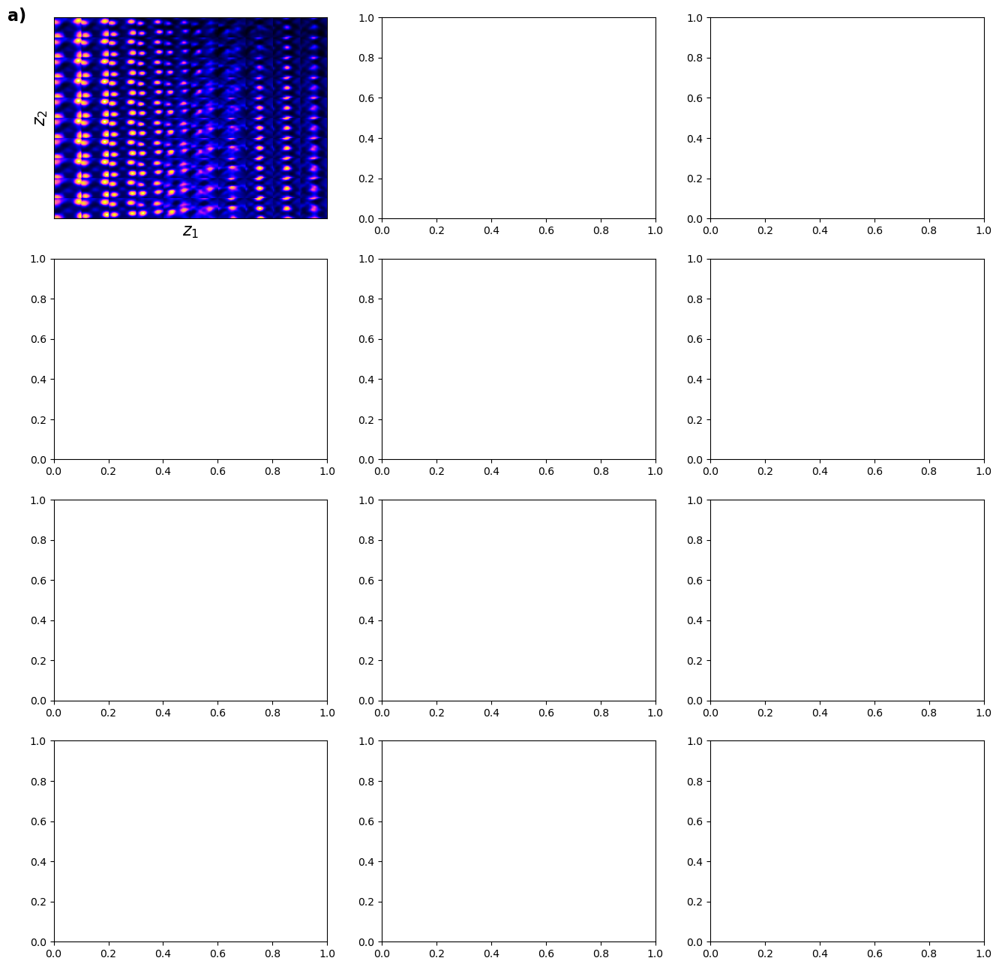

In [97]:
#| label: app:trVAE_widget_1
# fig_trVAE_widget_1

z1_lim = [min(z1), max(z1)]
z2_lim = [min(z2), max(z2)]
ang_lim = [min(ang), max(ang)]
tx_lim = [min(tx), max(tx)]
ty_lim = [min(ty), max(ty)]

# Define combinations for KDE scatter plots
combinations = [
    (z1, z2, r"$z_1$", r"$z_2$"),   # (b)
    (z1, ang, r"$z_1$", r"$\theta$"),   # (c)
    (z1, tx, r"$z_1$", r"$t_x$"),   # (d)
    (z1, ty, r"$z_1$", r"$t_y$"),   # (e)
    (z2, ang, r"$z_2$", r"$\theta$"),   # (f)
    (z2, tx, r"$z_2$", r"$t_x$"),   # (g)
    (z2, ty, r"$z_2$", r"$t_y$"),   # (h)
    (ang, tx, r"$\theta$", r"$t_x$"),   # (i)
    (ang, ty, r"$\theta$", r"$t_y$"),   # (j)
    (tx, ty, r"$t_x$", r"$t_y$")    # (k)
]

# Pre-defined axis limits for all variables
limits = {
    "z1": z1_lim, "z2": z2_lim, "ang": ang_lim, "tx": tx_lim, "ty": ty_lim
}

# Create figure with 4 rows and 3 columns
fig, axes = plt.subplots(4, 3, figsize=(16, 16))
axes = axes.flatten()  # Flatten axes for easy looping

# (a) Latent manifold plot in the first position
manifold = generate_latent_manifold(n=10, decoder=trvae.decode, target_size=(28, 28))
axes[0].imshow(manifold, cmap="gnuplot2", origin="upper", aspect="auto")
axes[0].set_xlabel(r"$z_1$", fontsize=16)
axes[0].set_ylabel(r"$z_2$", fontsize=16)
axes[0].set_xticks([]), axes[0].set_yticks([])
axes[0].text(-0.1, 1.05, 'a)', transform=axes[0].transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# Loop through combinations and plot KDE with scatter plots
for i, (x, y, xlabel, ylabel) in enumerate(combinations):
    ax = axes[i + 1]  # Start from the second subplot

    # Define consistent limits for x and y axes
    x_lim = limits[xlabel.strip('$')]
    y_lim = limits[ylabel.strip('$')]

    # KDE plot
    kde = gaussian_kde([x, y])
    X, Y = np.meshgrid(np.linspace(x_lim[0], x_lim[1], 200), np.linspace(y_lim[0], y_lim[1], 200))
    Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)
    levels = np.linspace(Z.min() + 0.1 * (Z.max() - Z.min()), Z.max(), 30)
    ax.contourf(X, Y, Z, levels=levels, cmap="jet", alpha=0.2)

    # Scatter plot on top
    ax.scatter(x, y, c="k", s=10, alpha=0.4, edgecolors="k")

    # Set labels, axis limits, and subplot labels
    ax.set_xlabel(xlabel, fontsize=16)
    ax.set_ylabel(ylabel, fontsize=16)
    ax.set_xlim(x_lim), ax.set_ylim(y_lim)
    ax.set_xticks([]), ax.set_yticks([])
    ax.text(-0.05, 1, f'{chr(98 + i)})', transform=ax.transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

# Hide unused subplots to avoid empty maps
for j in range(len(combinations) + 1, len(axes)):
    axes[j].set_visible(False)

# Adjust layout for better spacing
plt.tight_layout(pad=2.0)

# Show the plot
plt.show()


In [ ]:
# combinations = [
#     (z1, z2, "z1", "z2"),
#     (z1, ang, "z1", "ang"),
#     (z1, tx, "z1", "tx"),
#     (z1, ty, "z1", "ty"),
#     (z2, ang, "z2", "ang"),
#     (z2, tx, "z2", "tx"),
#     (z2, ty, "z2", "ty"),
#     (ang, tx, "ang", "tx"),
#     (ang, ty, "ang", "ty"),
#     (tx, ty, "tx", "ty")
# ]

# # Set up the figure with 4 rows and 3 columns (enough to hold all combinations)
# fig, axes = plt.subplots(4, 3, figsize=(16, 16))

# # Flatten the axes array to loop through easily
# axes = axes.flatten()

# # Loop through combinations and plot them
# for i, (x, y, xlabel, ylabel) in enumerate(combinations):
#     sns.kdeplot(x=x, y=y, fill=True, ax=axes[i], cmap='Blues', alpha=0.4, levels=10)
#     axes[i].scatter(x, y, c="b", s=20, alpha=0.6, edgecolors="k")
#     axes[i].set_xlabel(xlabel, fontsize=18)
#     axes[i].set_ylabel(ylabel, fontsize=18)
#     axes[i].set_xticks([])
#     axes[i].set_yticks([])

# # Hide unused subplots to avoid empty maps
# for j in range(len(combinations), len(axes)):
#     axes[j].set_visible(False)

# # Adjust layout for better spacing
# plt.tight_layout()

# # Show the plot
# plt.show()


Kamyar, can you configure it it os it does not show empty maps?

Latent maps

In [94]:

z1 = z1  # Latent variable 1
z2 = z2  # Latent variable 2
tx = tx  # Translation x
ty = ty  # Translation y
ang = ang  # Angular variable
Px = SBFOdata[1]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]]  # Ground truth Px
Py = SBFOdata[1]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]]  # Ground truth Py
coms_target = coms_target  # Coordinates for scatter plots

# Define options and data dictionary
options = ["z1", "z2", "tx", "ty", "ang", "Ground Truth Px", "Ground Truth Py"]
data_dict = {
    "z1": z1,
    "z2": z2,
    "tx": tx,
    "ty": ty,
    "ang": ang,
    "Ground Truth Px": Px,
    "Ground Truth Py": Py
}

# Interactive function for plotting selected variables in a 3x3 grid
def interactive_grid_plot(variable1, variable2):
    # Data combinations to plot
    data = [
        (data_dict[variable1], variable1),
        (data_dict[variable2], variable2)
    ]
    
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Plot for variable 1
    values1, title1 = data[0]
    if title1 in ["z1", "z2", "tx", "ty", "ang"]:
        axes[0].scatter(coms_target[:, 1], coms_target[:, 0], c=values1, s=10, cmap="jet", marker="s")
    else:
        axes[0].imshow(values1, cmap="jet", origin="lower")
    axes[0].set_title(title1, fontsize=16)
    axes[0].axis("off")

    # Plot for variable 2
    values2, title2 = data[1]
    if title2 in ["z1", "z2", "tx", "ty", "ang"]:
        axes[1].scatter(coms_target[:, 1], coms_target[:, 0], c=values2, s=10, cmap="jet", marker="s")
    else:
        axes[1].imshow(values2, cmap="jet", origin="lower")
    axes[1].set_title(title2, fontsize=16)
    axes[1].axis("off")

    plt.tight_layout()
    plt.show()

In [ ]:
#| label: app:trVAE_widget_2
# fig_trVAE_widget_2


ipywidgets.interact(
    interactive_grid_plot,
    variable1=widgets.Dropdown(options=options, value="z1", description="Variable 1"),
    variable2=widgets.Dropdown(options=options, value="z2", description="Variable 2")
)

interactive(children=(Dropdown(description='Variable 1', options=('z1', 'z2', 'tx', 'ty', 'ang', 'Ground Truth…

<function __main__.interactive_grid_plot(variable1, variable2)>

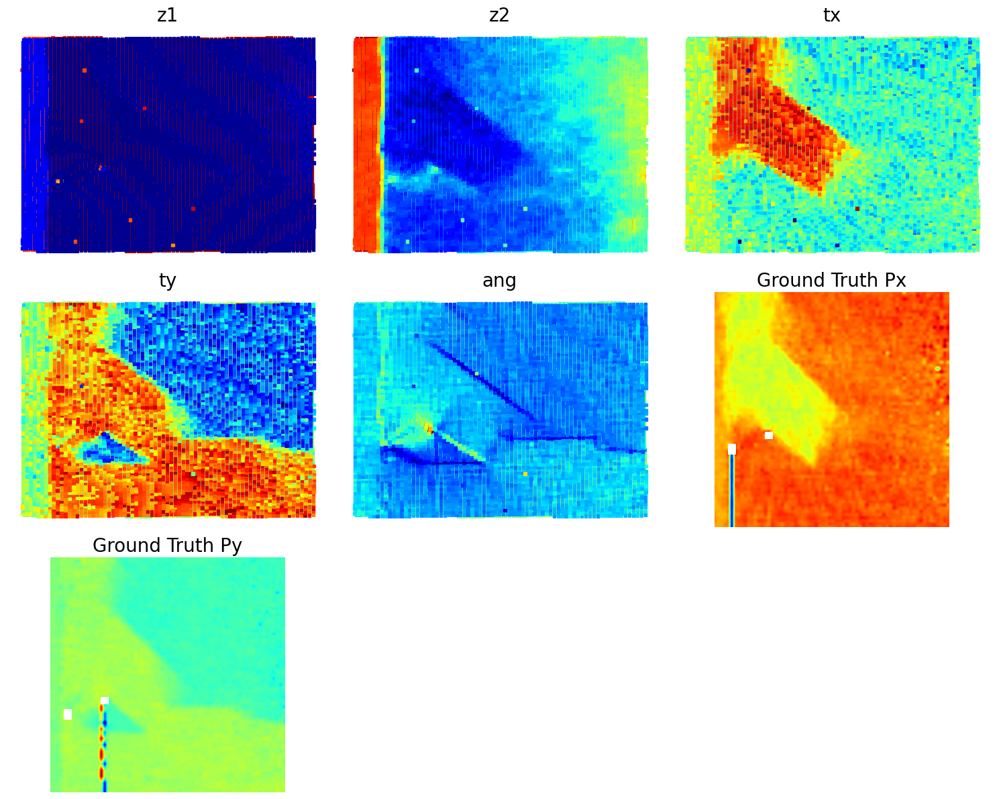

In [ ]:
# data = [
#     (z1, "z1"),
#     (z2, "z2"),
#     (tx, "tx"),
#     (ty, "ty"),
#     (ang, "ang"),
#     (SBFOdata[1]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Px"),
#     (SBFOdata[1]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Py")
# ]

# # Set up the figure with 3 rows and 3 columns (since we have 8 datasets to plot)
# fig, axes = plt.subplots(3, 3, figsize=(15, 12))

# # Flatten the axes array for easier looping
# axes = axes.flatten()

# # Loop through data and plot each in the respective subplot
# for i, (values, title) in enumerate(data):
#     if i < 5:  # Plotting latent variables and physical variables
#         scatter = axes[i].scatter(coms_target[:, 1], coms_target[:, 0], c=values, s=10, cmap='jet', marker="s")
#     else:  # Plotting Ground Truth Px and Py
#         im = axes[i].imshow(values, cmap='jet', origin='lower')

#     axes[i].set_title(title, fontsize=20)
#     axes[i].axis("off")

# # Hide the unused subplot to avoid empty maps
# for j in range(len(data), len(axes)):
#     axes[j].set_visible(False)

# # Adjust layout for better spacing
# plt.tight_layout()

# # Show the plot
# plt.show()


Bingo! Now our z2 map is **only** chemical and mistilt effects, tx and ty look like polarization, and angle is polarization rotation.

## CVAE

However, our analysis above had a signnificant limitation. We were looking for latent representation common for A- and B-site cations, even though these are obviously different. Now, we are going to explore the conditional VAE, that consider cation type as **known** variable. Let's see how it works!

condition 1: Set the conditiona as A and B site atoms of the material

In [ ]:
w = (40,40)
min_sigma = 1
max_sigma = 5
threshold = 0.025
overlap = 0.0
descriptors_c, coms_target_c, all_atoms_c, coordinates_c, subimages_target_c = build_descriptor(w,
                                                                                                min_sigma,
                                                                                                max_sigma,
                                                                                                threshold,
                                                                                                overlap)

print(descriptors_c.shape)
print(subimages_target_c.shape)
print(coms_target_c.shape)
print(all_atoms_c.shape)
print(coordinates_c.shape)


labels_c, valid_subimages  = Fit_GMM(descriptors_c, 2, "full")
print(labels_c.shape)

(10917, 1600)
(10917, 40, 40)
(10917, 2)
(11813, 3)
(11813, 2)
(10917,)


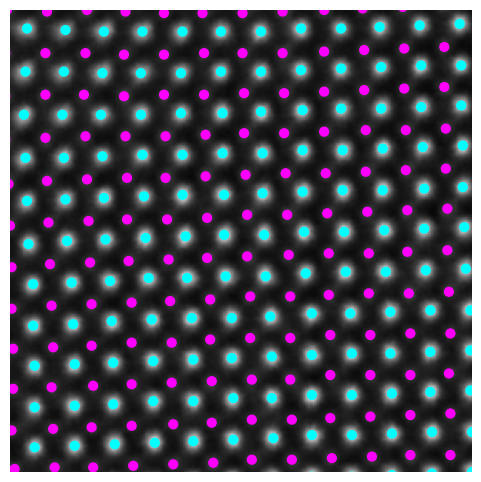

In [ ]:
plt.figure(figsize=(6, 6))
plt.imshow(image, cmap='gray')
plt.scatter(coms_target_c[:, 1], coms_target_c[:, 0], c=labels_c,  s=40, cmap='cool', marker= "o")


plt.xlim([400,700])
plt.ylim([400,700])
plt.axis('off')
plt.show()

Data prepareation

In [ ]:
subimages_target_reshaped = np.expand_dims(subimages_target, axis=-1)
train_data = torch.tensor(subimages_target_reshaped[:,:,:,0]).float()
lab_train = pv.utils.to_onehot(tt(labels_c).to(torch.int64), 2)
train_loader = pv.utils.init_dataloader(train_data.unsqueeze(1), lab_train, batch_size=48)

In [ ]:
in_dim = (window_size[0],window_size[1])

# Initialize vanilla VAE
Cvae = pv.models.iVAE(in_dim, latent_dim=2, c_dim = 2, # Number of latent conditions
                     hidden_dim_e = [512, 512],
                     hidden_dim_d = [512, 512], # corresponds to the number of neurons in the hidden layers of the decoder
                     invariances=None, seed=0)
# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(Cvae)

# Train for n epochs:
for e in range(10):
    trainer.step(train_loader)
    trainer.print_statistics()

Epoch: 1 Training loss: 857.8553
Epoch: 2 Training loss: 835.0532
Epoch: 3 Training loss: 834.4928
Epoch: 4 Training loss: 833.9724
Epoch: 5 Training loss: 833.8125
Epoch: 6 Training loss: 833.4621
Epoch: 7 Training loss: 833.2291
Epoch: 8 Training loss: 832.9384
Epoch: 9 Training loss: 832.9468
Epoch: 10 Training loss: 832.9426


Varitional Auto Encoder manifold representation

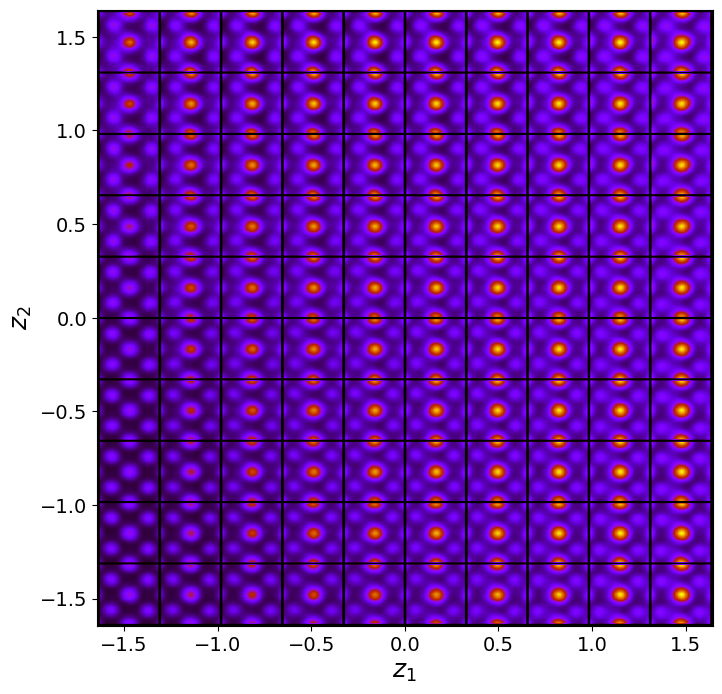

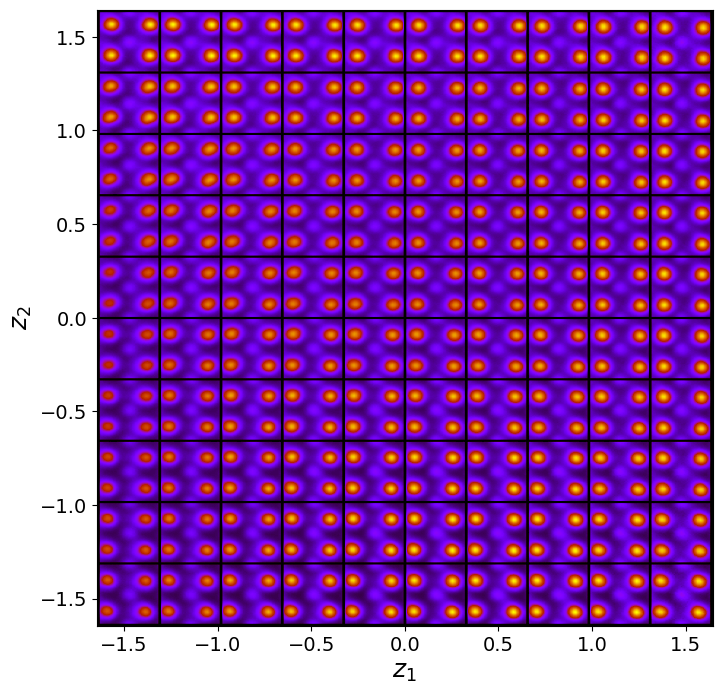

In [ ]:
for cls in range(2):
    cls = pv.utils.to_onehot(tt([cls,]), 2)
    Cvae.manifold2d(d=10, y=cls, cmap="gnuplot")

Now we have two latent spaces - for A-type and B-type separately.

In [ ]:
Cvae_z_mean, Cvae_z_sd = Cvae.encode(train_data.unsqueeze(-1), lab_train)
print('no. of defects', Cvae_z_mean.shape)

z1 = Cvae_z_mean[:, -2]
z2 = Cvae_z_mean[:, -1]

no. of defects torch.Size([10917, 2])


Latent representation

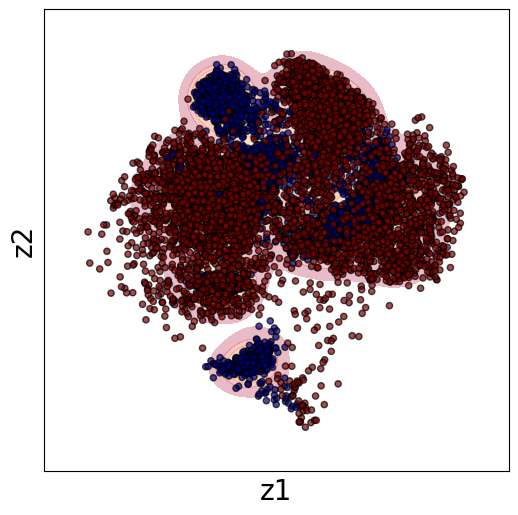

In [ ]:
plt.figure(figsize=(6, 6))

# Create the KDE plot for density estimation
sns.kdeplot(x=z1, y=z2, cmap='Spectral', fill=True, alpha=0.3, levels=10)

# Create the scatter plot with enhancements
plt.scatter(z1, z2, c=labels_c, s=20, alpha=0.7, edgecolors="k", cmap='jet')

# Set labels and remove ticks for a minimalist style
plt.xlabel("z1", fontsize=20)
plt.ylabel("z2", fontsize=20)
plt.xticks([])
plt.yticks([])

# Show the plot
plt.show()


Latent maps

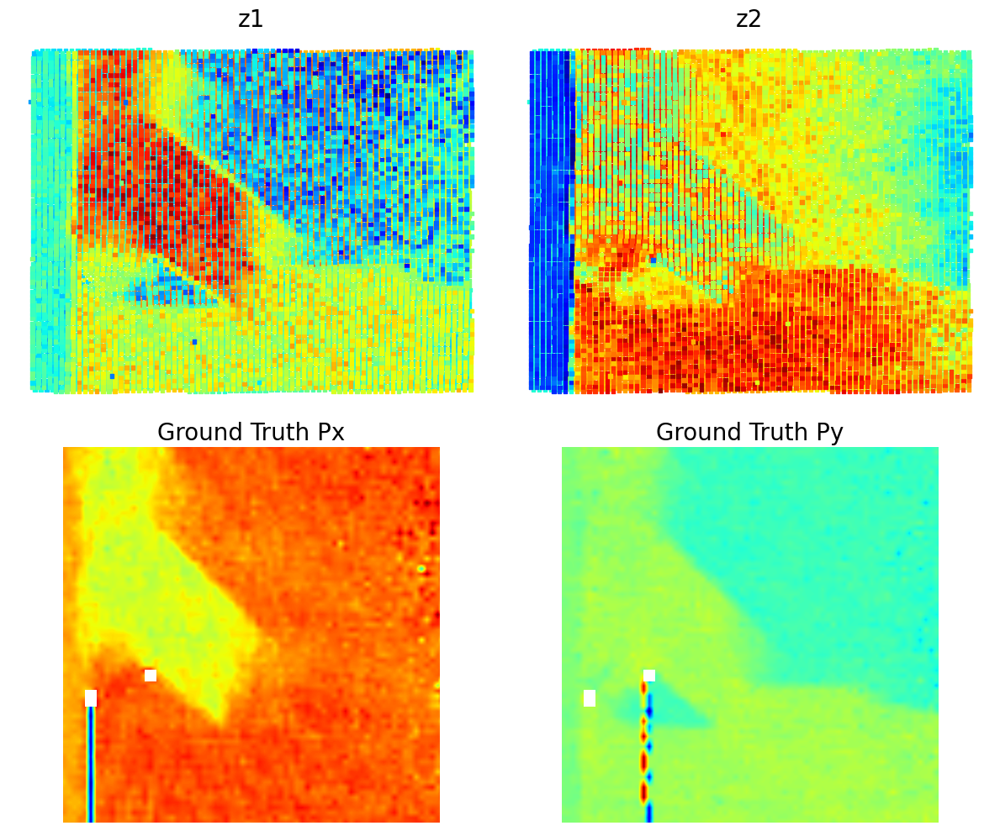

In [ ]:
# Define the data to plot and corresponding titles
data = [
    (z1, "z1"),
    (z2, "z2"),
    (SBFOdata[1]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Px"),
    (SBFOdata[1]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Py")
]

# Set up the figure with 2 rows and 2 columns
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Flatten the axes array for easier looping
axes = axes.flatten()

# Loop through the data and plot each in the respective subplot
for i, (values, title) in enumerate(data):
    if i < 2:  # Plotting z1 and z2 using scatter plot
        axes[i].scatter(coms_target[:, 1], coms_target[:, 0], c=values, s=10, cmap='jet', marker="s")
    else:  # Plotting Ground Truth Px and Py using imshow
        im = axes[i].imshow(values, cmap='jet', origin='lower')

    # Set title and turn off axis
    axes[i].set_title(title, fontsize=20)
    axes[i].axis("off")

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


Now, we are starting to see something new. Note that we see anomalous behavior of the z1 at the "diffuse" domain walls. So, what's going on? Lets start to add invariances!

## CrVAE

In [ ]:
in_dim = (window_size[0],window_size[1])

# Initialize vanilla VAE
Crvae = pv.models.iVAE(in_dim, latent_dim=2, c_dim = 2, # Number of latent conditions
                     hidden_dim_e = [512,512],   # corresponds to the number of neurons in the hidden layers of the encoder
                     hidden_dim_d = [512,512],# corresponds to the number of neurons in the hidden layers of the decoder
                       # corresponds to the number of neurons in the hidden layers of the decoder
                     invariances=["r"], seed=0)
# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(Crvae)

# Train for n epochs:
for e in range(10):
    trainer.step(train_loader)
    trainer.print_statistics()

Epoch: 1 Training loss: 961.0602
Epoch: 2 Training loss: 903.1231
Epoch: 3 Training loss: 857.5174
Epoch: 4 Training loss: 844.1828
Epoch: 5 Training loss: 841.8324
Epoch: 6 Training loss: 842.1628
Epoch: 7 Training loss: 840.9638
Epoch: 8 Training loss: 840.6636
Epoch: 9 Training loss: 840.0012
Epoch: 10 Training loss: 839.6627


Varitional Auto Encoder manifold representation

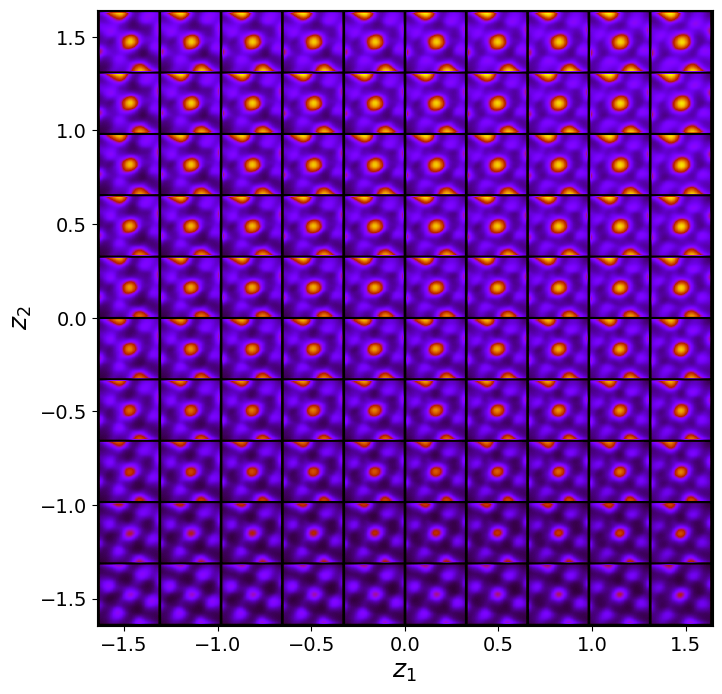

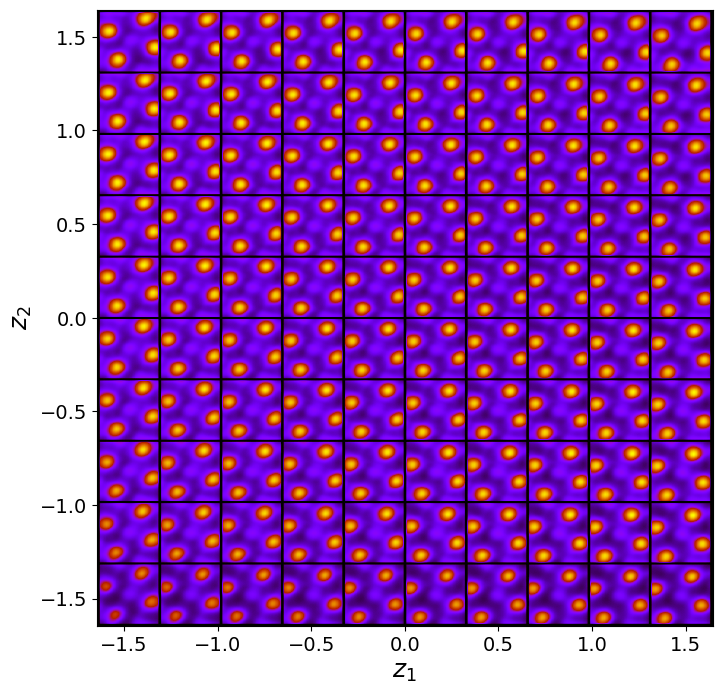

In [ ]:
for cls in range(2):
    cls = pv.utils.to_onehot(tt([cls,]), 2)
    Crvae.manifold2d(d=10, y=cls, cmap="gnuplot")

In [ ]:
Crvae_z_mean, Crvae_z_sd = Crvae.encode(train_data.unsqueeze(-1), lab_train)
print('no. of defects', Crvae_z_mean.shape)

z1 = Crvae_z_mean[:, -2]
z2 = Crvae_z_mean[:, -1]
ang = Crvae_z_mean[:, 0]

no. of defects torch.Size([10917, 3])


Latent representation

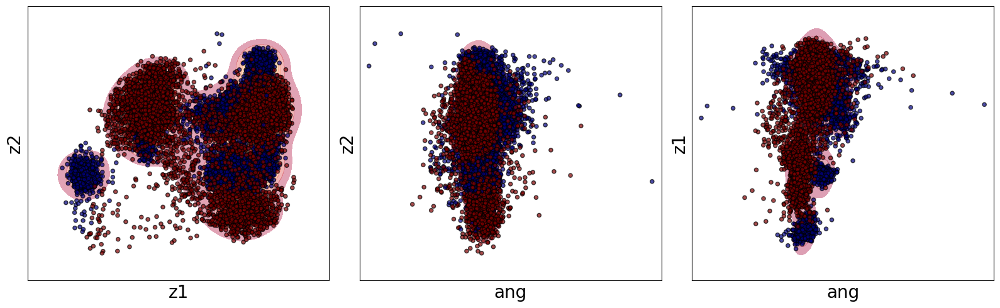

In [ ]:
# Set up the figure with 1 row and 3 columns
fig, axes = plt.subplots(1, 3, figsize=(16, 5))

# First plot: z1 vs. z2 with KDE
sns.kdeplot(x=z1, y=z2, ax=axes[0], cmap='Spectral', fill=True, alpha=0.4, levels=10)
axes[0].scatter(z1, z2, c=labels_c, s=20, alpha=0.7, edgecolors="k", cmap='jet')
axes[0].set_xlabel("z1", fontsize=20)
axes[0].set_ylabel("z2", fontsize=20)
axes[0].set_xticks([])
axes[0].set_yticks([])

# Second plot: ang vs. z2 with KDE
sns.kdeplot(x=ang, y=z2, ax=axes[1], cmap='Spectral', fill=True, alpha=0.4, levels=10)
axes[1].scatter(ang, z2, c=labels_c, s=20, alpha=0.7, edgecolors="k", cmap='jet')
axes[1].set_xlabel("ang", fontsize=20)
axes[1].set_ylabel("z2", fontsize=20)
axes[1].set_xticks([])
axes[1].set_yticks([])

# Third plot: ang vs. z1 with KDE
sns.kdeplot(x=ang, y=z1, ax=axes[2], cmap='Spectral', fill=True, alpha=0.4, levels=10)
axes[2].scatter(ang, z1, c=labels_c, s=20, alpha=0.7, edgecolors="k", cmap='jet')
axes[2].set_xlabel("ang", fontsize=20)
axes[2].set_ylabel("z1", fontsize=20)
axes[2].set_xticks([])
axes[2].set_yticks([])

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()

Latent maps

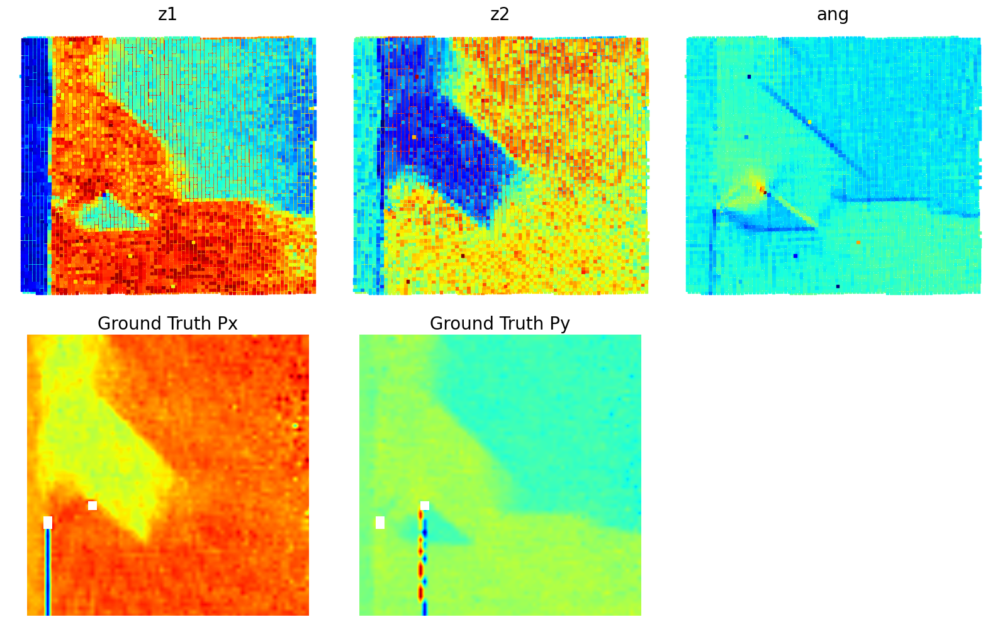

In [ ]:
# Define the data to plot in two rows
data = [
    (z1, "z1"),
    (z2, "z2"),
    (ang, "ang"),
    (SBFOdata[1]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Px"),
    (SBFOdata[1]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Py")
]

# Set up the figure with 2 rows and 3 columns (since we have 5 datasets to plot)
fig, axes = plt.subplots(2, 3, figsize=(16, 10))

# Flatten the axes array for easier looping
axes = axes.flatten()

# Loop through the data and plot each in the respective subplot
for i, (values, title) in enumerate(data):
    if i < 3:  # Plotting z1, z2, and ang using scatter plot
        axes[i].scatter(coms_target[:, 1], coms_target[:, 0], c=values, s=10, cmap='jet', marker="s")
    else:  # Plotting Ground Truth Px and Py using imshow
        im = axes[i].imshow(values, cmap='jet', origin='lower')

    # Set title and turn off axis
    axes[i].set_title(title, fontsize=20)
    axes[i].axis("off")

# Hide the unused subplot to avoid any empty map
axes[-1].set_visible(False)

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


## CtVAE

In [ ]:
in_dim = (window_size[0],window_size[1])

# Initialize vanilla VAE
Ctvae = pv.models.iVAE(in_dim, latent_dim=2, c_dim = 2, # Number of latent conditions
                     hidden_dim_e = [512,512],   # corresponds to the number of neurons in the hidden layers of the encoder
                     hidden_dim_d = [512,512],# corresponds to the number of neurons in the hidden layers of the decoder
                       # corresponds to the number of neurons in the hidden layers of the decoder
                     invariances=["t"], seed=0)
# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(Ctvae)

# Train for n epochs:
for e in range(10):
    trainer.step(train_loader)
    trainer.print_statistics()

Epoch: 1 Training loss: 964.6775
Epoch: 2 Training loss: 921.2808
Epoch: 3 Training loss: 885.0366
Epoch: 4 Training loss: 854.1404
Epoch: 5 Training loss: 841.2021
Epoch: 6 Training loss: 839.1421
Epoch: 7 Training loss: 838.3705
Epoch: 8 Training loss: 837.5571
Epoch: 9 Training loss: 838.1362
Epoch: 10 Training loss: 837.3278


Varitional Auto Encoder manifold representation

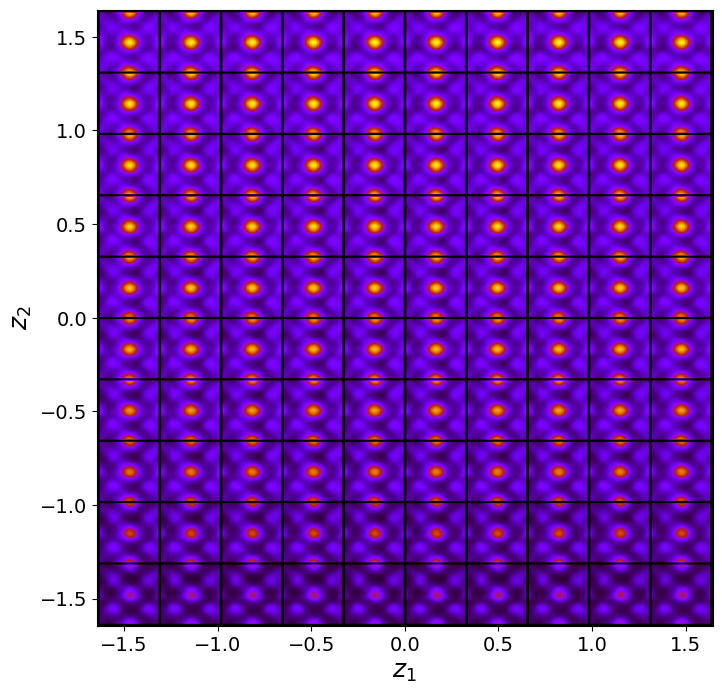

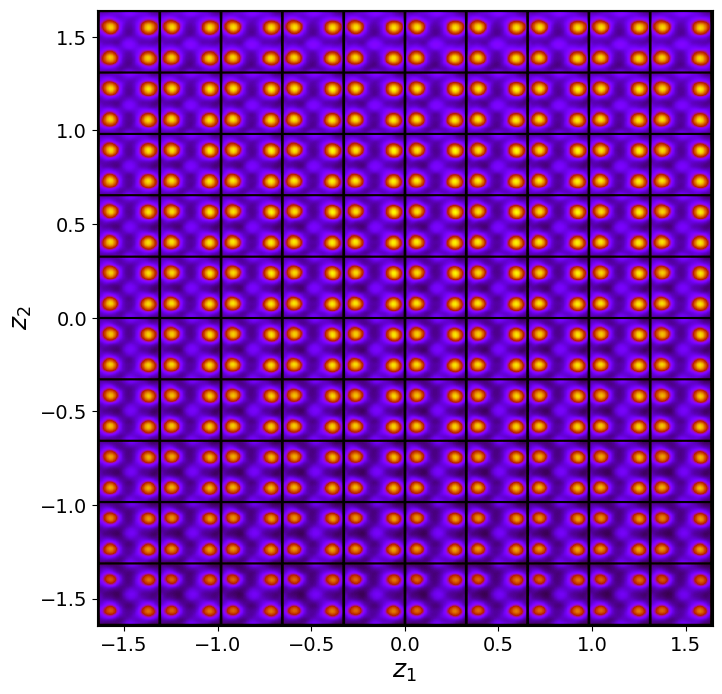

In [ ]:
for cls in range(2):
    cls = pv.utils.to_onehot(tt([cls,]), 2)
    Ctvae.manifold2d(d=10, y=cls, cmap="gnuplot")

In [ ]:
Ctvae_z_mean, Ctvae_z_sd = Ctvae.encode(train_data.unsqueeze(-1), lab_train)
print('no. of defects', Ctvae_z_mean.shape)

z1 = Ctvae_z_mean[:, -2]
z2 = Ctvae_z_mean[:, -1]
tx = Ctvae_z_mean[:, -4]
ty = Ctvae_z_mean[:, -3]

no. of defects torch.Size([10917, 4])


Latent representation

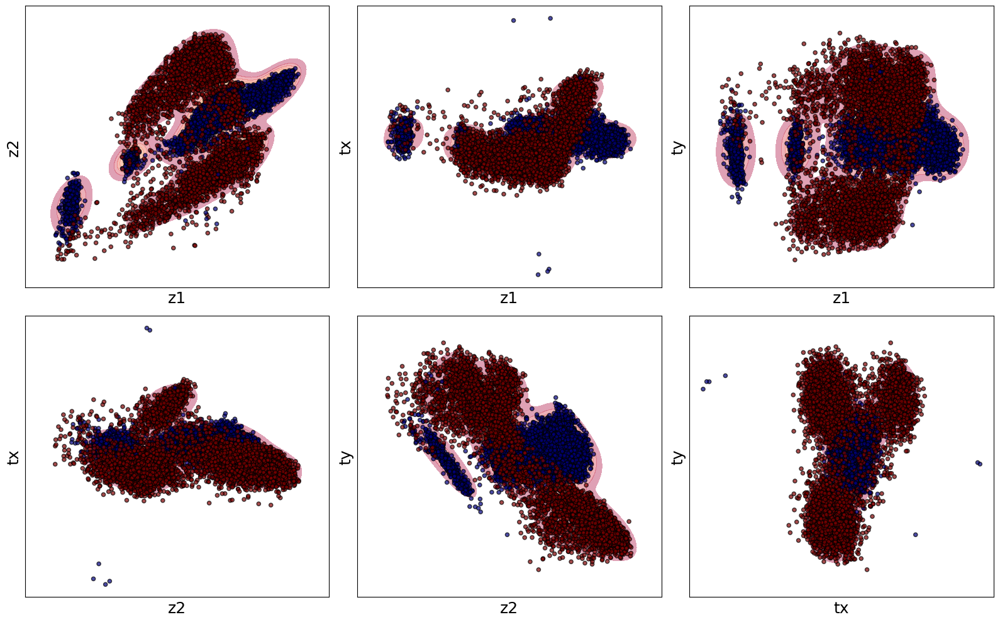

In [ ]:
# Define the data combinations you want to plot in the 4x3 grid
combinations = [
    (z1, z2, "z1", "z2"),
    (z1, tx, "z1", "tx"),
    (z1, ty, "z1", "ty"),
    (z2, tx, "z2", "tx"),
    (z2, ty, "z2", "ty"),
    (tx, ty, "tx", "ty"),
]

# Set up the figure with 2 rows and 3 columns
fig, axes = plt.subplots(2, 3, figsize=(16, 10))

# Flatten the axes array to loop through easily
axes = axes.flatten()

# Loop through combinations and plot them
for i, (x, y, xlabel, ylabel) in enumerate(combinations):
    # Plot KDE first
    sns.kdeplot(x=x, y=y, ax=axes[i], cmap='Spectral', fill=True, alpha=0.4, levels=10)

    # Scatter plot on top of KDE
    axes[i].scatter(x, y, c=labels_c, s=20, alpha=0.7, edgecolors="k", cmap='jet')

    # Set labels and axis properties
    axes[i].set_xlabel(xlabel, fontsize=18)
    axes[i].set_ylabel(ylabel, fontsize=18)
    axes[i].set_xticks([])
    axes[i].set_yticks([])

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


Latent maps

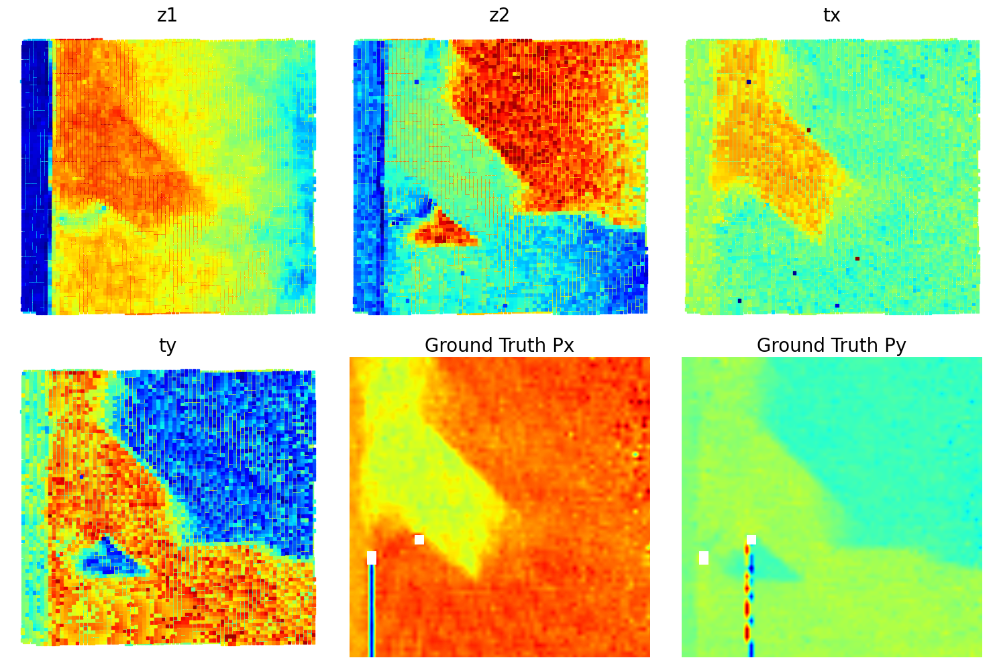

In [ ]:
# Define the data to plot and corresponding titles, including ground truth Px and Py
data = [
    (z1, "z1"),
    (z2, "z2"),
    (tx, "tx"),
    (ty, "ty"),
    (SBFOdata[1]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Px"),
    (SBFOdata[1]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Py")
]

# Set up the figure with 2 rows and 3 columns (since we have 6 datasets to plot)
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the axes array for easier looping
axes = axes.flatten()

# Loop through data and plot each in the respective subplot
for i, (values, title) in enumerate(data):
    if i < 4:  # Plotting z1, z2, tx, ty using scatter
        scatter = axes[i].scatter(coms_target[:, 1], coms_target[:, 0], c=values, s=10, cmap='jet', marker="s")
    else:  # Plotting Ground Truth Px and Py using imshow
        im = axes[i].imshow(values, cmap='jet', origin='lower')

    # Set title and turn off axis
    axes[i].set_title(title, fontsize=20)
    axes[i].axis("off")

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


Here, looks like both z1,z2 and tx,ty contain information about domain strucutres. However, do we have too many latent variables here?

## CtrVAE

In [ ]:
in_dim = (window_size[0],window_size[1])

# Initialize vanilla VAE
Ctrvae = pv.models.iVAE(in_dim, latent_dim=2, c_dim = 2,  # Number of latent dimensions other than the invariancies
                     hidden_dim_e = [512, 512],
                     hidden_dim_d = [512, 512], # corresponds to the number of neurons in the hidden layers of the decoder
                     invariances=["r", "t"], seed=0)

# Initialize SVI trainer
trainer = pv.trainers.SVItrainer(Ctrvae)

# Train for n epochs:
for e in range(10):
    trainer.step(train_loader)
    trainer.print_statistics()

Epoch: 1 Training loss: 953.7108
Epoch: 2 Training loss: 925.4445
Epoch: 3 Training loss: 891.5939
Epoch: 4 Training loss: 873.9561
Epoch: 5 Training loss: 847.9449
Epoch: 6 Training loss: 845.5858
Epoch: 7 Training loss: 844.0638
Epoch: 8 Training loss: 843.2363
Epoch: 9 Training loss: 842.4737
Epoch: 10 Training loss: 842.4788


Varitional Auto Encoder manifold representation

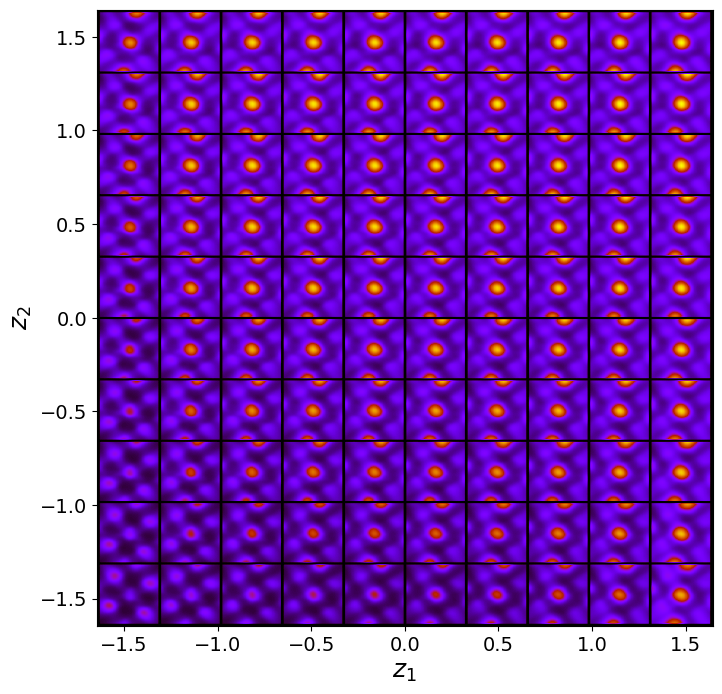

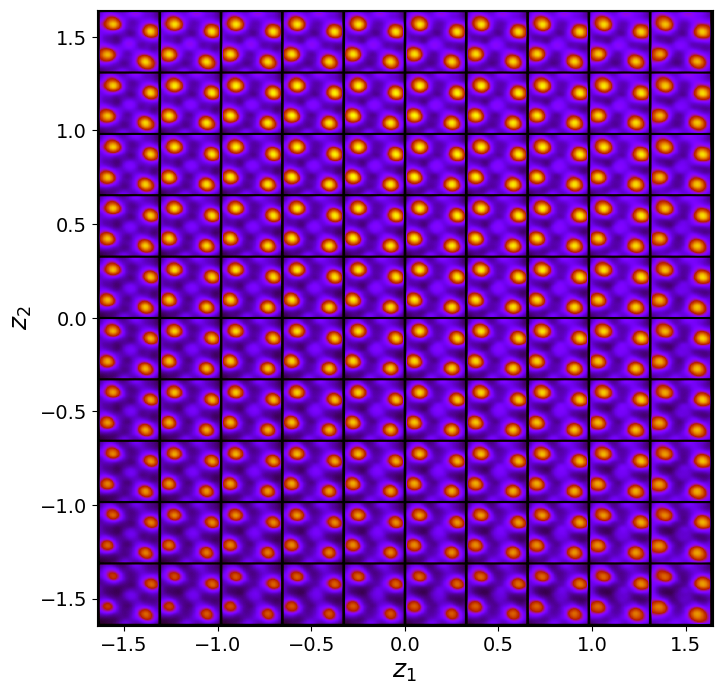

In [ ]:
for cls in range(2):
    cls = pv.utils.to_onehot(tt([cls,]), 2)
    Ctrvae.manifold2d(d=10, y=cls, cmap="gnuplot")

In [ ]:
Ctrvae_z_mean, Ctrvae_z_sd = Ctrvae.encode(train_data.unsqueeze(-1), lab_train)
print('no. of defects', Ctrvae_z_mean.shape)

z1 = Ctrvae_z_mean[:, -2]
z2 = Ctrvae_z_mean[:, -1]
ang = Ctrvae_z_mean[:, 0]
tx = Ctrvae_z_mean[:, -4]
ty = Ctrvae_z_mean[:, -3]

no. of defects torch.Size([10917, 5])


Latent Representations

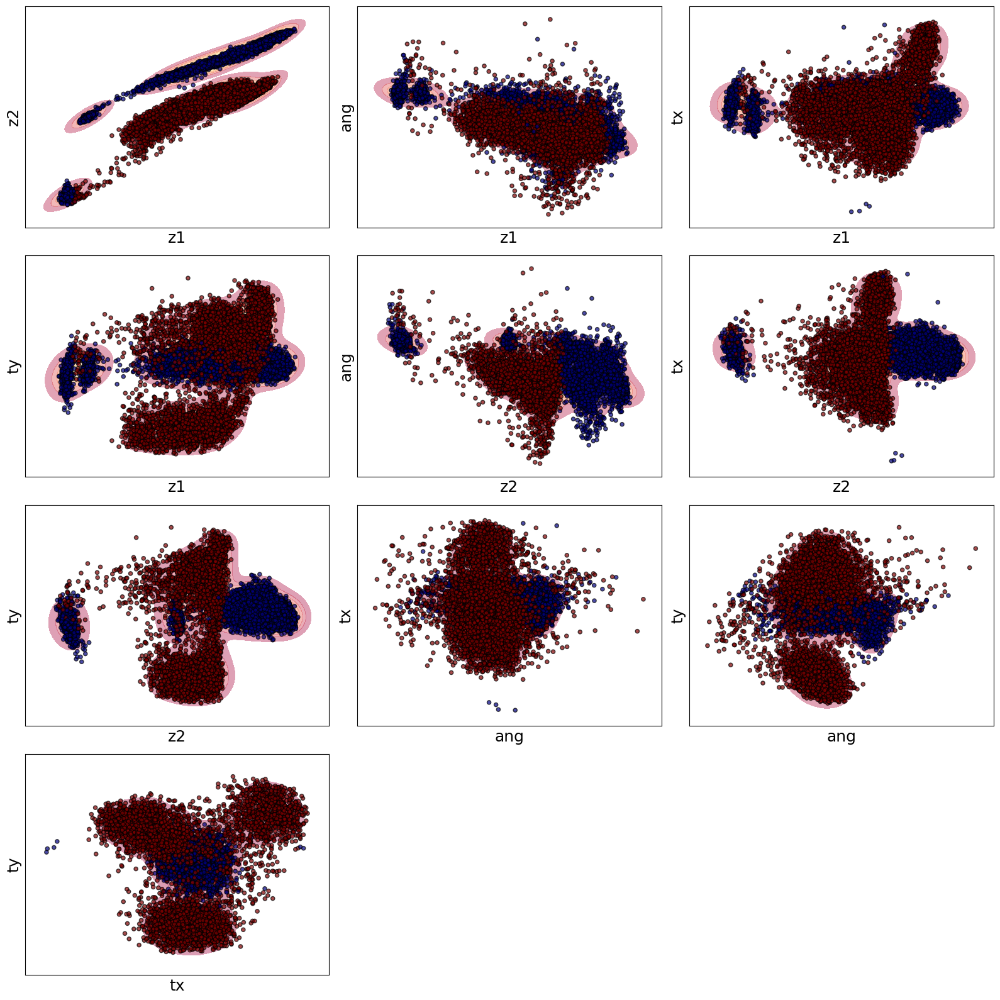

In [ ]:
# Define the data combinations manually for all unique pairs
combinations = [
    (z1, z2, "z1", "z2"),
    (z1, ang, "z1", "ang"),
    (z1, tx, "z1", "tx"),
    (z1, ty, "z1", "ty"),
    (z2, ang, "z2", "ang"),
    (z2, tx, "z2", "tx"),
    (z2, ty, "z2", "ty"),
    (ang, tx, "ang", "tx"),
    (ang, ty, "ang", "ty"),
    (tx, ty, "tx", "ty")
]

# Set up the figure with 4 rows and 3 columns (enough to hold all combinations)
fig, axes = plt.subplots(4, 3, figsize=(16, 16))

# Flatten the axes array to loop through easily
axes = axes.flatten()

# Loop through combinations and plot them
for i, (x, y, xlabel, ylabel) in enumerate(combinations):
    # Plot KDE first
    sns.kdeplot(x=x, y=y, ax=axes[i], cmap='Spectral', fill=True, alpha=0.4, levels=10)

    # Scatter plot on top of KDE
    scatter = axes[i].scatter(x, y, c=labels_c, s=20, alpha=0.7, edgecolors="k", cmap='jet')

    # Set labels and axis properties
    axes[i].set_xlabel(xlabel, fontsize=18)
    axes[i].set_ylabel(ylabel, fontsize=18)
    axes[i].set_xticks([])
    axes[i].set_yticks([])

# Hide unused subplots to avoid empty maps
for j in range(len(combinations), len(axes)):
    axes[j].set_visible(False)

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


Latent maps

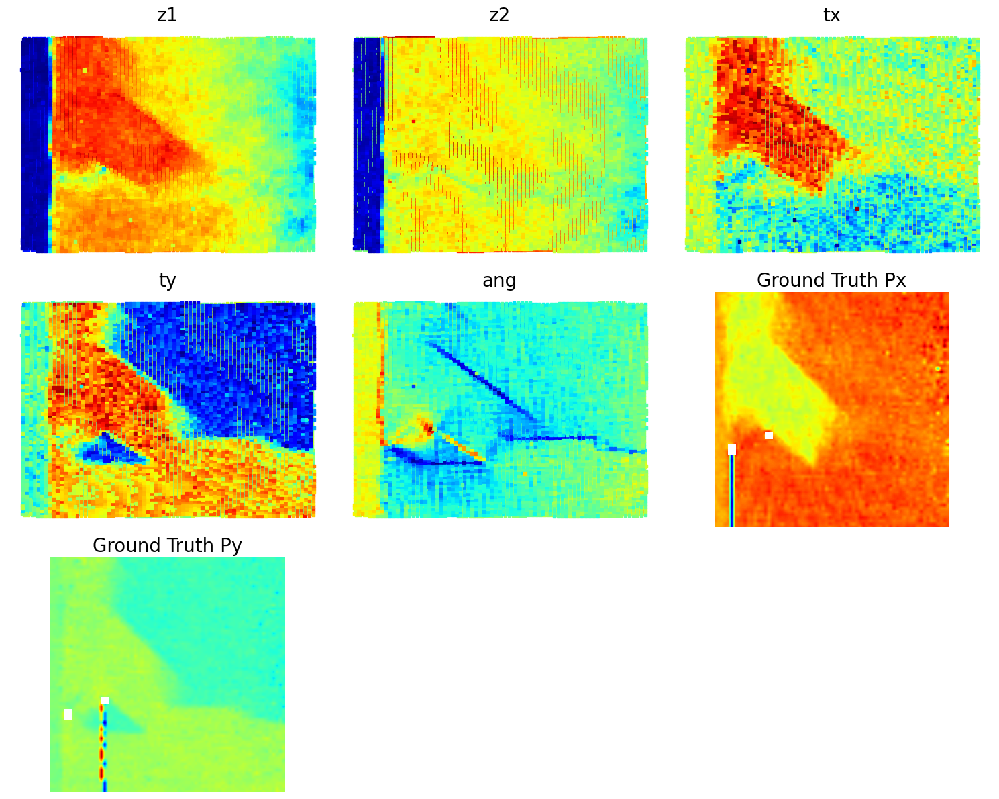

In [ ]:
# Define the data to plot and corresponding titles, including ground truth Px and Py
data = [
    (z1, "z1"),
    (z2, "z2"),
    (tx, "tx"),
    (ty, "ty"),
    (ang, "ang"),
    (SBFOdata[1]["ab_Px_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Px"),
    (SBFOdata[1]["ab_Py_resized"][main[0]:main[1], main[2]:main[3]], "Ground Truth Py")
]

# Set up the figure with 3 rows and 3 columns (since we have 7 datasets to plot)
fig, axes = plt.subplots(3, 3, figsize=(15, 12))

# Flatten the axes array for easier looping
axes = axes.flatten()

# Loop through data, plot each in the respective subplot
for i, (values, title) in enumerate(data):
    if i < 5:  # Plotting latent variables and physical variables
        scatter = axes[i].scatter(coms_target[:, 1], coms_target[:, 0], c=values, s=10, cmap='jet', marker="s")
    else:  # Plotting Ground Truth Px and Py
        im = axes[i].imshow(values, cmap='jet', origin='lower')

    axes[i].set_title(title, fontsize=20)
    axes[i].axis("off")

# Hide the unused subplot to avoid empty maps
for j in range(len(data), len(axes)):
    axes[j].set_visible(False)

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


Now, it looks like we definitely have too many latent variables - our information starts to become somewhat redundant. Compare the z2 and angle.

Sumamry: Troughout htis notebook, we have taken you on the whirlwind tour of the invariant and conditional VAEs. By intorducing the invariances, we both allow the data to speak for itself (via latent variables), and separate physical meaning (translations and rotations). We have also tried to explain the logic that we can follow in choosing the right VAE, going forward and backward between the data and physical interpetations and expectations. ALready in this form, you can use thi snotebook for your own data sets - whether these are ferroics, multiphase materials, or otehr systems.

However, you can also ask questions:
- How do we know that the number of latents and chosen invariances are correct?
- How do we know which descriptor to choose (here we use the patch of size w, and w can be a variable. Also, we can choos emore complex descriptors, e.g. rectangular pathcches w1,w2, or even more complex objects)
- What about more complex invariances?

After all, here we eseentially did iterative epxloration in small, but still combinatorial space. It turns out, we can **optimize** thes eparameters using the reward function based approach - stand by for futher papers form our group!
